In [1]:
# !pip install datasets
# !pip install transformers
# !pip install -U accelerate
# !pip install optuna
# !pip install shap
# !pip install lime
# !pip install transformers-interpret
# !pip install omnixai
# !pip install ipython>=8.10.0
# !pip install captum
# !pip install git+https://github.com/yidinghao/interpreting-nlp
# !pip install yattag

#Data

In [2]:
import pickle

with open('train_final.pkl', 'rb') as f:
    X_train = pickle.load(f)

with open('test_final.pkl', 'rb') as f:
    X_test = pickle.load(f)

with open('val_final.pkl', 'rb') as f:
    X_dev = pickle.load(f)

In [3]:
label_to_class = {
    0: 'none',
    1: 'anger',
    2: 'joy',
    3: 'sadness',
    4: 'love',
    5: 'sympathy',
    6: 'surprise',
    7: 'fear'
}

classes = ['none', 'anger', 'joy', 'sadness', 'love', 'sympathy', 'surprise', 'fear']

In [4]:
X_train.head()

,tweet,label,tweet_with_out_emojis,cleaned_data,Root Stemming,Light Stemming
5081,1996 يا مهند ياحبيبي انت تدور لبش مع اي احد ...,1,1996 يا مهند ياحبيبي انت تدور لبش مع اي احد ...,مهند ياحبيبي تدور لبش متاكد ابو جاسم مايدري,هند حبب تدر لبش تكد ابو جسم ايدر,مهند ياحبيبي تدور لبش متاكد ابو جاسم مايدري
8264,حلب عفرين اعتقال عشرات الشباب من قريه باسوطه ...,3,حلب عفرين اعتقال عشرات الشباب من قريه باسوطه ...,حلب عفرين اعتقال عشرات الشباب قريه باسوطه ريف ...,حلب عفر عقل عشر شبب قره بسط ريف عفر قوت هرب عش...,حلب عفر اعتقال عشر الشباب قريه باسوطه ريف عفر ...
9777,انا نفسي مره اجرب اكون ليك حد اقرب : ),3,انا نفسي مره اجرب اكون ليك حد اقرب : ),مره اجرب اكون ليك اقرب,مره جرب اكن ليك قرب,مره اجرب اكون ليك اقرب
740,الصراحه احساس مخزي ونحن نكتفي بالتمثيل المشرف ...,3,الصراحه احساس مخزي ونحن نكتفي بالتمثيل المشرف ...,الصراحه احساس مخزي نكتفي بالتمثيل المشرف الاول...,صرح حسس خزي كتف شرف اوليمبياد عوز صحه ريض,الصراحه احساس مخزي نكتفي بالتمثيل المشرف الاول...
6537,57 عاجل الايطالي فابيو باسل يفوز بدهب الاولي...,0,57 عاجل الايطالي فابيو باسل يفوز بدهب الاولي...,عاجل الايطالي فابيو باسل يفوز بدهب الاوليمبياد...,عجل يطل ابو بسل يفز دهب اوليمبياد جودو بطل علم...,عاجل الايطالي فابيو باسل يفوز بدهب الاوليمبياد...


In [5]:
X_train = X_train[['tweet', 'Light Stemming', 'label']]
y_train = X_train['label']
X_test = X_test[['tweet', 'Light Stemming', 'label']]
y_test = X_test['label']
X_dev = X_dev[['tweet', 'Light Stemming', 'label']]
y_dev = X_dev['label']

In [6]:
X_train.shape, X_test.shape, X_dev.shape

((7045, 3), (1510, 3), (1510, 3))

In [7]:
X_train

,tweet,Light Stemming,label
5081,1996 يا مهند ياحبيبي انت تدور لبش مع اي احد ...,مهند ياحبيبي تدور لبش متاكد ابو جاسم مايدري,1
8264,حلب عفرين اعتقال عشرات الشباب من قريه باسوطه ...,حلب عفر اعتقال عشر الشباب قريه باسوطه ريف عفر ...,3
9777,انا نفسي مره اجرب اكون ليك حد اقرب : ),مره اجرب اكون ليك اقرب,3
740,الصراحه احساس مخزي ونحن نكتفي بالتمثيل المشرف ...,الصراحه احساس مخزي نكتفي بالتمثيل المشرف الاول...,3
6537,57 عاجل الايطالي فابيو باسل يفوز بدهب الاولي...,عاجل الايطالي فابيو باسل يفوز بدهب الاوليمبياد...,0
...,...,...,...
5734,احمد الاحمر اوحش لاعب في الاوليمبياد ... اخره ...,احمد الاحمر اوحش لاعب الاوليمبياد اخره تضخيم ا...,3
5191,انتي كان قصدك عليا !,انتي قصدك عليا,6
5390,يا جدعان لو سمحتوا مش كل واحد عنده ميتين ام عق...,جدع سمحت مش واحد ميت ام عقده نفسيه يروح داخل ش...,1
860,هتودينا في دهيا يا بلال ارحمنا ده مش وقت قلش,هتودي دهيا بلال ارحم مش قلش,1


In [8]:
X_train = X_train.rename_axis('id')
X_test = X_test.rename_axis('id')
X_dev = X_dev.rename_axis('id')

X_train = X_train.reset_index(drop=True)
X_test = X_test.reset_index(drop=True)
X_dev = X_dev.reset_index(drop=True)

In [9]:
from datasets import Dataset

X_train = Dataset.from_pandas(X_train)
X_test = Dataset.from_pandas(X_test)
X_dev = Dataset.from_pandas(X_dev)
X_train, X_test, X_dev

(Dataset({
     features: ['tweet', 'Light Stemming', 'label'],
     num_rows: 7045
 }),
 Dataset({
     features: ['tweet', 'Light Stemming', 'label'],
     num_rows: 1510
 }),
 Dataset({
     features: ['tweet', 'Light Stemming', 'label'],
     num_rows: 1510
 }))

#Transformer

##Setup

In [10]:
model_checkpoint = 'hatemnoaman/bert-base-arabic-finetuned-emotion'

In [11]:
from transformers import AutoTokenizer

tokenizer = AutoTokenizer.from_pretrained(model_checkpoint, use_fast=True)

In [12]:
# from transformers import AutoModelForSequenceClassification
from interpret_nlp.modules.lrp_bert_modules import LRPBertForSequenceClassification

# model_init = lambda: AutoModelForSequenceClassification.from_pretrained(model_checkpoint, num_labels=8)
model_init = lambda: LRPBertForSequenceClassification.from_pretrained(model_checkpoint, num_labels=8)

In [13]:
def tokenize_function(examples):
    return tokenizer(examples["Light Stemming"], padding="max_length", truncation=True, max_length=37)

X_train = X_train.map(tokenize_function, batched=True, num_proc = 8)
X_dev = X_test.map(tokenize_function, batched=True, num_proc = 8)
X_test = X_test.map(tokenize_function, batched=True, num_proc = 8)

Map (num_proc=8):   0%|          | 0/7045 [00:00<?, ? examples/s]

Map (num_proc=8):   0%|          | 0/1510 [00:00<?, ? examples/s]

Map (num_proc=8):   0%|          | 0/1510 [00:00<?, ? examples/s]

In [14]:
X_train

Dataset({
    features: ['tweet', 'Light Stemming', 'label', 'input_ids', 'token_type_ids', 'attention_mask'],
    num_rows: 7045
})

##Training

In [15]:
import numpy as np
from sklearn.metrics import (accuracy_score,
                             f1_score,
                             precision_score,
                             recall_score
                             )

def compute_metrics(p):
    preds = np.argmax(p.predictions, axis=1)
    assert len(preds) == len(p.label_ids)

    macro_f1 = f1_score(p.label_ids,preds,average='macro', zero_division=1)
    macro_precision = precision_score(p.label_ids,preds,average='macro', zero_division=1)
    macro_recall = recall_score(p.label_ids,preds,average='macro', zero_division=1)
    acc = accuracy_score(p.label_ids,preds)
    return {
      'macro_f1' : macro_f1,
      'macro_precision': macro_precision,
      'macro_recall': macro_recall,
      'accuracy': acc
    }

In [16]:
# best run parameters
# dict_items([('learning_rate', 5.9572096694887074e-05), ('num_train_epochs', 4), ('seed', 34), ('per_device_train_batch_size', 16)])

In [17]:
from transformers import TrainingArguments, Trainer, EarlyStoppingCallback, IntervalStrategy

batch_size = 32
logging_steps = 100
num_epochs = 2

training_args = TrainingArguments(output_dir="./train")
training_args.do_train = True
training_args.evaluate_during_training = True
training_args.per_device_train_batch_size = batch_size
training_args.per_device_eval_batch_size = batch_size
training_args.evaluation_strategy = IntervalStrategy.STEPS
training_args.num_train_epochs = num_epochs
training_args.logging_steps = logging_steps
training_args.eval_steps = logging_steps
training_args.save_steps = 500
training_args.save_total_limit = 5
training_args.seed = 24
training_args.learning_rate = 3.3456955493456956e-06
training_args.load_best_model_at_end=True
training_args.metric_for_best_model = 'macro_f1'

In [18]:
trainer = Trainer(
    model_init=model_init,
    args=training_args,
    train_dataset=X_train,
    eval_dataset=X_dev,
    compute_metrics=compute_metrics,
    callbacks=[EarlyStoppingCallback(early_stopping_patience=3)]
)

In [19]:
# best_run = trainer.hyperparameter_search(n_trials=10, direction="maximize")
# best_run

In [20]:
# best_run.hyperparameters.items()
# dict_items([('learning_rate', 3.3456955493456956e-06), ('num_train_epochs', 2), ('seed', 24), ('per_device_train_batch_size', 32)])

In [21]:
# for n, v in best_run.hyperparameters.items():
#     setattr(trainer.args, n, v)

trainer.train()

/usr/local/lib/python3.10/dist-packages/transformers/optimization.py:411: FutureWarning: This implementation of AdamW is deprecated and will be removed in a future version. Use the PyTorch implementation torch.optim.AdamW instead, or set `no_deprecation_warning=True` to disable this warning
  warnings.warn(


Step,Training Loss,Validation Loss,Macro F1,Macro Precision,Macro Recall,Accuracy
100,0.603600,0.525783,0.837066,0.842567,0.835566,0.839073
200,0.597700,0.493077,0.843971,0.850891,0.840560,0.845033
300,0.522600,0.495314,0.842526,0.847419,0.840698,0.844371
400,0.519400,0.489622,0.848419,0.851791,0.846763,0.850331


TrainOutput(global_step=442, training_loss=0.5553673360142772, metrics={'train_runtime': 112.3842, 'train_samples_per_second': 125.374, 'train_steps_per_second': 3.933, 'total_flos': 267920070177120.0, 'train_loss': 0.5553673360142772, 'epoch': 2.0})

In [22]:
trainer.evaluate()

{'eval_loss': 0.491301566362381,
 'eval_macro_f1': 0.8448036850399652,
 'eval_macro_precision': 0.8492053750229391,
 'eval_macro_recall': 0.8426772855678732,
 'eval_accuracy': 0.8463576158940397,
 'eval_runtime': 3.5422,
 'eval_samples_per_second': 426.294,
 'eval_steps_per_second': 13.551,
 'epoch': 2.0}

##Testing

In [23]:
import torch

device = "cuda" if torch.cuda.is_available() else "cpu"
device

'cuda'

In [24]:
from torch.utils.data import TensorDataset, DataLoader

input_ids = [i['input_ids'] for i in X_test]
attention_masks = [i['attention_mask'] for i in X_test]

inputs = torch.tensor(input_ids)
masks = torch.tensor(attention_masks)
test_data = TensorDataset(inputs, masks)

test_dataloader = DataLoader(test_data, batch_size=batch_size)

In [25]:
from sklearn.metrics import classification_report

model = trainer.model
model.eval()
model.to(device)

test_pred = []
for input, masks in test_dataloader:
    torch.cuda.empty_cache()

    input = input.to(device)
    masks = masks.to(device)

    output = model(input, attention_mask=masks)['logits']
    predictions = torch.argmax(output, dim=1)
    predictions = predictions.cpu().detach().numpy()

    test_pred.extend(predictions)

print(classification_report(X_test['label'], test_pred, target_names=classes))

              precision    recall  f1-score   support

        none       0.82      0.87      0.85       229
       anger       0.82      0.88      0.85       200
         joy       0.79      0.77      0.78       205
     sadness       0.77      0.82      0.79       185
        love       0.90      0.91      0.90       193
    sympathy       0.94      0.88      0.91       156
    surprise       0.79      0.67      0.73       154
        fear       0.97      0.95      0.96       188

    accuracy                           0.85      1510
   macro avg       0.85      0.84      0.84      1510
weighted avg       0.85      0.85      0.85      1510



#Samples to Explain

In [26]:
print(label_to_class)

{0: 'none', 1: 'anger', 2: 'joy', 3: 'sadness', 4: 'love', 5: 'sympathy', 6: 'surprise', 7: 'fear'}


In [27]:
misclassified_indexes = [112, 883, 189, 350, 1491, 36, 238, 956]
correctly_classified_indexes = [24, 29, 31, 270, 171, 107, 116, 126]

In [28]:
# misclassified samples
test_pred = np.array(test_pred)
test_true = np.array(X_test['label'])

##Dig Missclassified Examples

In [29]:
# lets find some misclassified examles
c = 0
for i in range(len(test_pred)):
  if test_pred[i] != test_true[i] and test_true[i] == 7:
    sample = X_test['tweet'][i]
    print(f'index: {i}')
    print(f'sample: {sample}')
    print(f'true label {classes[test_true[i]]}')
    print(f'pred label {classes[test_pred[i]]}')
    print("--------------------------------------------------------")
    c += 1
    if c == 30:
      break

index: 0
sample: طب هنعيش ازاي من غير رفع اثقال من هنا لحد الاوليمبياد الجايه بعد 4 سنين...؟؟
true label fear
pred label none
--------------------------------------------------------
index: 422
sample: انا عندي فوبيا من الظلام والاماكن العاليه والاماكن الفاضيه ☠️☠️☠️
true label fear
pred label sadness
--------------------------------------------------------
index: 424
sample: الاوليمبياد ده هايهيج ديك ابونا 😂 Rio2016
true label fear
pred label anger
--------------------------------------------------------
index: 548
sample: قولوا الكلمه بسرعه في السر اهو تبقي اتقالت و خلاص
true label fear
pred label surprise
--------------------------------------------------------
index: 749
sample: 2015 سنه فرديه ربنا يستر علينا كلنا !
true label fear
pred label surprise
--------------------------------------------------------
index: 767
sample: انجزوا بقي يارب محمد يارب  StaracArabia  DoaaElSebaii
true label fear
pred label joy
--------------------------------------------------------
index: 855
sampl

##Dig Correctly Classified Examples

In [30]:
# lets find some misclassified examles
c = 0
for i in range(len(test_pred)):
  if test_pred[i] == test_true[i] and test_true[i] == 7:
    sample = X_test['tweet'][i]
    print(f'index: {i}')
    print(f'sample: {sample}')
    print(f'true label {classes[test_true[i]]}')
    print(f'pred label {classes[test_pred[i]]}')
    print("--------------------------------------------------------")
    c += 1
    if c == 30:
      break

index: 4
sample: she3er: سمعت ان الحنين يقصرّ الاعمار ! انا خايف تغيب اكثر و   احتضرك
true label fear
pred label fear
--------------------------------------------------------
index: 5
sample: اعتقال مغربي قتل اسبانيا بشكل مروع | ماذا جري
true label fear
pred label fear
--------------------------------------------------------
index: 10
sample: يـوجعنـي قـلـبي،لمـا اتمـسك بانسان وانـا خايـفه يتـركنـي،تـوجعنـي فكـره ان النـاس كلهـم مـؤقتـين ومجـرد عـابريـن.💔
true label fear
pred label fear
--------------------------------------------------------
index: 16
sample: : مُش معقول انا ايدي لامسه ايديك .. خايف اكون يا حبيبي بحلم بيك.
true label fear
pred label fear
--------------------------------------------------------
index: 22
sample: n alroqi: فيني من الله قلي كيف ما فيك خوف . . سلطان بن نايف
true label fear
pred label fear
--------------------------------------------------------
index: 33
sample: حقيقي انا خايفه من التغير الجاي اكتر من نتيجه الماتش
true label fear
pred label fear
---------

##Find their predictions !

In [31]:
correct_samples = X_test.to_pandas().loc[correctly_classified_indexes][['tweet', 'Light Stemming', 'label']]
wrong_samples = X_test.to_pandas().loc[misclassified_indexes][['tweet', 'Light Stemming', 'label']]

In [32]:
correct_samples

,tweet,Light Stemming,label
24,هو في كام قطري في بعثه قطر في الاوليمبياد؟,كام قطري بعثه قطر الاوليمبياد,0
29,هو الواد محمد هاني ده مقموص من حاجه!! يعني جي ...,الواد محمد هاني مقموص حاجه جي يلعب غصب ببلاش م...,1
31,صوتك ده ايه الله عليه ملايكه بيغنوا ...,صوتك الله ملايكه بيغن,2
270,: حتي اقرب الشخاص ~ يخذلوننا ~ وما اقساها من ...,اقرب الشخاص يخذلون اقسا خيبه حزن,3
171,انا بقربگ اعيش الهنا 💋💕🍃,بقربگ اعيش اله حب حب,4
107,ذوي الاحتياجات فئه يجب ان تذلل لهم جميع العقبا...,الاحتياج فئه يجب تذلل العقب الله عون,5
116,ده كل لما مصر تفتح معبر يحصل تفجير كل دي صدف؟,مصر تفتح معبر يحصل تفجير صدف,6
126,انا كل الي خايفه منه ان يطلع عندي امتحان بكره ...,خايفه يطلع امتح بكره معرفش,7


In [33]:
wrong_samples

,tweet,Light Stemming,label
112,ماتش ليفربول و برشلونه مع الاوليمبياد ،،، توقي...,ماتش ليفربول برشلونه الاوليمبياد توقيت مش مناس...,0
883,هيا الاوليمبياد دي هتخلص امتي عشان انا اتخنقت,الاوليمبياد هتخلص امتي عشان اتخنقت,1
189,يا،ما شاء الله مصر في الاوليمبياد,ياما شاء الله مصر الاوليمبياد,2
350,الملاعب بتاعت الاوليمبياد سيئه جداً,الملاعب بتاعت الاوليمبياد سيئه,3
1491,عمر السومه افضل محترف يمر علي الكره السعوديه ه...,عمر السومه افضل محترف يمر الكره السعوديه معترض,4
36,الله يسعدكم. ويكون معكم,الله يسعد ويك,5
238,ايه دا 😨 !! زي الملايكه اما تشوفها والله ياجدع...,خوف الملايكه اما تشوف والله ياجدع,6
956,الصبر لسه ساكت يا ويلي من سكاته,الصبر لسه ساكت ويلي سكاته,7


In [34]:
correct_samples = correct_samples.rename_axis('id')
correct_samples = correct_samples.reset_index(drop=True)
correct_samples = Dataset.from_pandas(correct_samples)

wrong_samples = wrong_samples.rename_axis('id')
wrong_samples = wrong_samples.reset_index(drop=True)
wrong_samples = Dataset.from_pandas(wrong_samples)

In [35]:
correct_samples = correct_samples.map(tokenize_function, batched=True, num_proc = 8)
wrong_samples = wrong_samples.map(tokenize_function, batched=True, num_proc = 8)

Map (num_proc=8):   0%|          | 0/8 [00:00<?, ? examples/s]

Map (num_proc=8):   0%|          | 0/8 [00:00<?, ? examples/s]

In [36]:
from torch.utils.data import TensorDataset, DataLoader

input_ids = [i['input_ids'] for i in wrong_samples]
attention_masks = [i['attention_mask'] for i in wrong_samples]

samples_inputs = torch.tensor(input_ids)
samples_masks = torch.tensor(attention_masks)
sample_data = TensorDataset(samples_inputs, samples_masks)

samples_dataloader = DataLoader(sample_data)

In [37]:
from sklearn.metrics import classification_report

wrong_outputs = []

model.eval()
for input, masks in samples_dataloader:
    torch.cuda.empty_cache()

    input = input.to(device)
    masks = masks.to(device)

    output = model(input, attention_mask=masks)['logits']
    predictions = torch.argmax(output, dim=1)
    predictions = predictions.cpu().detach().numpy()

    wrong_outputs.extend(predictions)

# true labels for the misclassified samples
true_labels = X_test.to_pandas().loc[misclassified_indexes]['label'].values.tolist()

In [38]:
correct_outputs = [0, 1, 2, 3, 4, 5, 6, 7]
classes, true_labels, wrong_outputs, correct_outputs

(['none', 'anger', 'joy', 'sadness', 'love', 'sympathy', 'surprise', 'fear'],
 [0, 1, 2, 3, 4, 5, 6, 7],
 [6, 3, 3, 0, 6, 2, 7, 3],
 [0, 1, 2, 3, 4, 5, 6, 7])

#Explainable AI XAI

In [42]:
def print_sample(index, wrong):

  if wrong:
    samples = wrong_samples
    outputs = wrong_outputs
  else:
    samples = correct_samples
    outputs = correct_outputs

  original_sample = samples['tweet'][index]
  preprocs_sample = samples['Light Stemming'][index]
  true_label = classes[samples['label'][index]]
  pred_label = classes[outputs[index]]
  print(f'tweet: {original_sample}, true label: {true_label}')
  print(f'light: {preprocs_sample}, pred label: {pred_label}')

  return preprocs_sample

##Pipeline

In [40]:
from transformers import pipeline

# build a pipeline object to do predictions
pred = pipeline("text-classification", model=model, tokenizer=tokenizer, device=device, top_k=None, return_all_scores=True)

Xformers is not installed correctly. If you want to use memory_efficient_attention to accelerate training use the following command to install Xformers
pip install xformers.
The model 'LRPBertForSequenceClassification' is not supported for text-classification. Supported models are ['AlbertForSequenceClassification', 'BartForSequenceClassification', 'BertForSequenceClassification', 'BigBirdForSequenceClassification', 'BigBirdPegasusForSequenceClassification', 'BioGptForSequenceClassification', 'BloomForSequenceClassification', 'CamembertForSequenceClassification', 'CanineForSequenceClassification', 'ConvBertForSequenceClassification', 'CTRLForSequenceClassification', 'Data2VecTextForSequenceClassification', 'DebertaForSequenceClassification', 'DebertaV2ForSequenceClassification', 'DistilBertForSequenceClassification', 'ElectraForSequenceClassification', 'ErnieForSequenceClassification', 'ErnieMForSequenceClassification', 'EsmForSequenceClassification', 'FalconForSequenceClassification',

##SHAP

In [51]:
import shap

shap.initjs()
shap_explainer = shap.Explainer(pred, output_names=classes)

In [52]:
from shap.plots import waterfall, bar
def show_plots(prediction, index, wrong, plot='waterfall', max_display=None):

  if wrong:
    samples = wrong_samples
  else:
    samples = correct_samples

  print_sample(index, wrong)

  sv = shap_explainer(samples['Light Stemming'])
  show = sv[index, :, prediction]

  if plot == 'waterfall':
    if max_display is not None:
      waterfall(show, max_display=max_display)
    else:
      waterfall(show)
  elif plot == 'bar':
    if max_display is not None:
      bar(show, max_display=max_display)
    else:
      bar(show)

###Waterfall Plot

####Misclassified

tweet: ماتش ليفربول و برشلونه مع الاوليمبياد ،،، توقيت مش مناسب الصراحه, true label: none
light: ماتش ليفربول برشلونه الاوليمبياد توقيت مش مناسب الصراحه, pred label: surprise


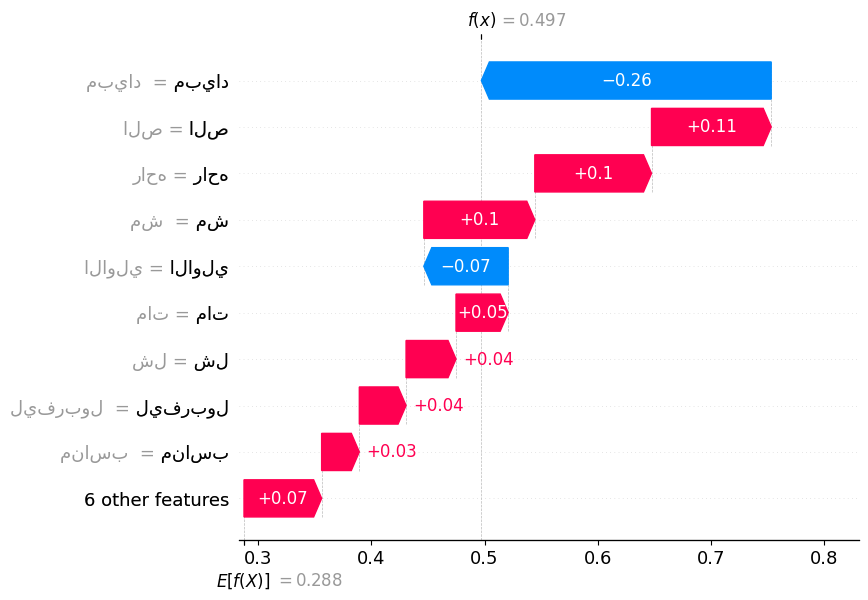

tweet: هيا الاوليمبياد دي هتخلص امتي عشان انا اتخنقت, true label: anger
light: الاوليمبياد هتخلص امتي عشان اتخنقت, pred label: sadness


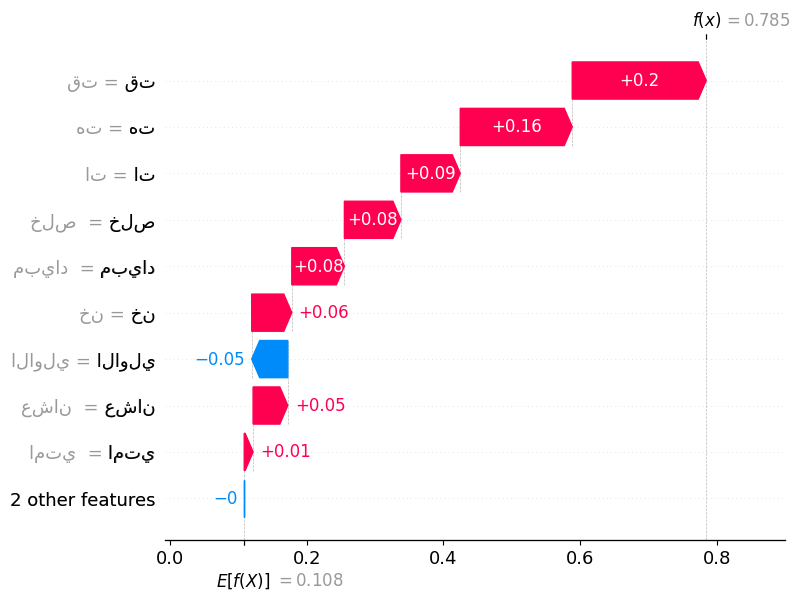

tweet: يا،ما شاء الله  مصر في الاوليمبياد, true label: joy
light: ياما شاء الله مصر الاوليمبياد, pred label: sadness


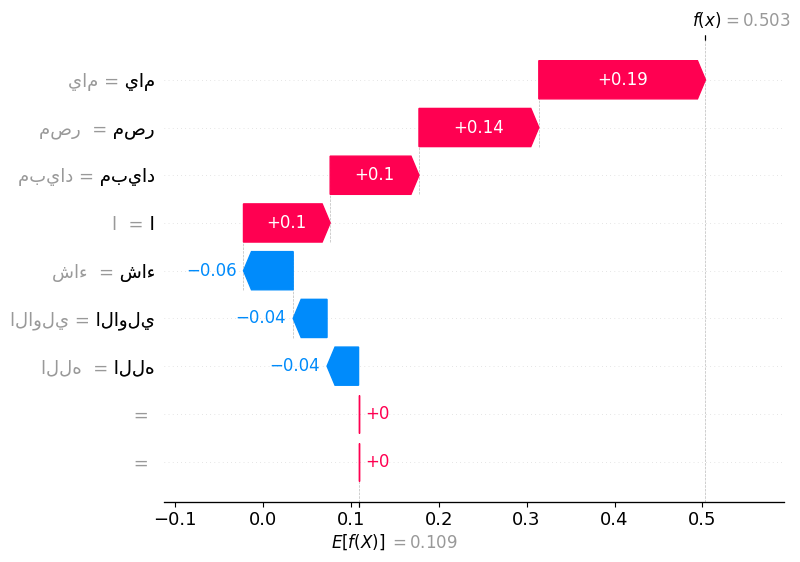

tweet: الملاعب بتاعت الاوليمبياد سيئه جداً, true label: sadness
light: الملاعب بتاعت الاوليمبياد سيئه, pred label: none


Partition explainer: 9it [00:12,  6.37s/it]


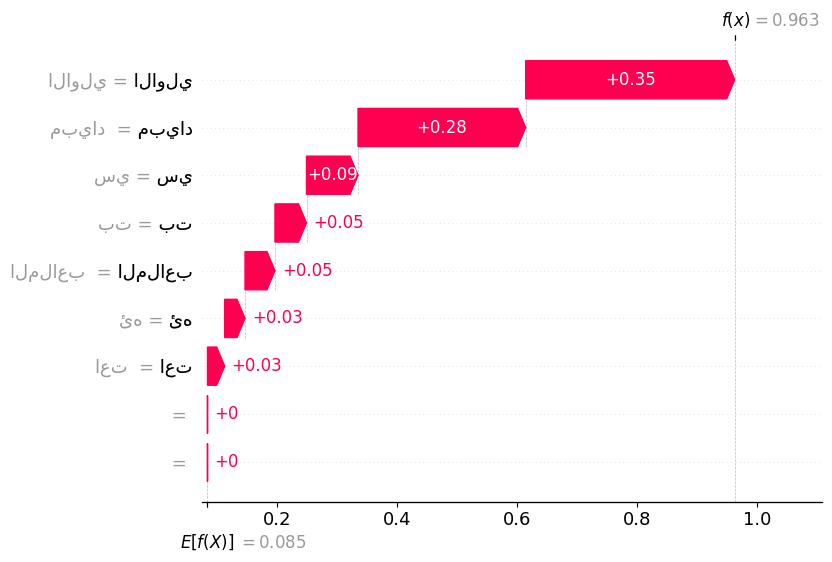

tweet: عمر السومه افضل محترف يمر علي الكره السعوديه هل من معترض ., true label: love
light: عمر السومه افضل محترف يمر الكره السعوديه معترض, pred label: surprise


Partition explainer: 9it [00:14,  3.72s/it]


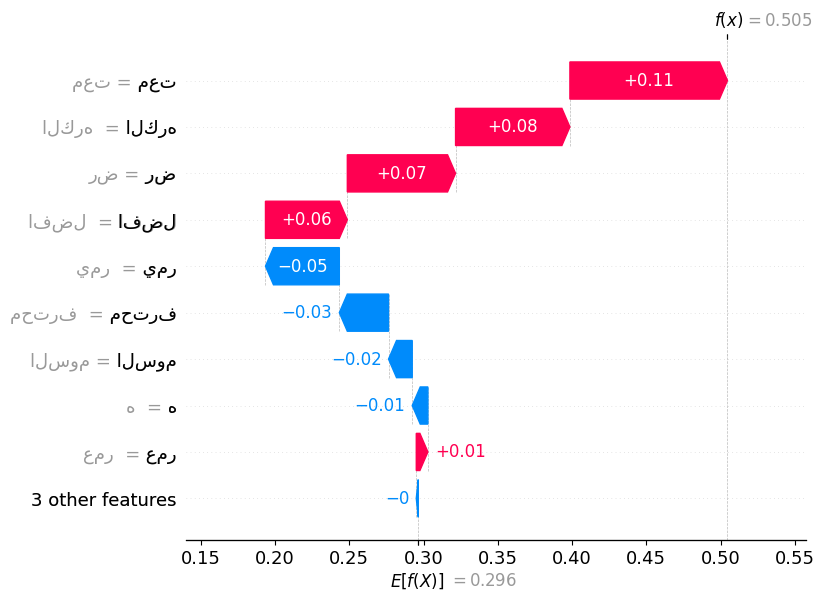

tweet: الله يسعدكم. ويكون معكم, true label: sympathy
light: الله يسعد ويك, pred label: joy


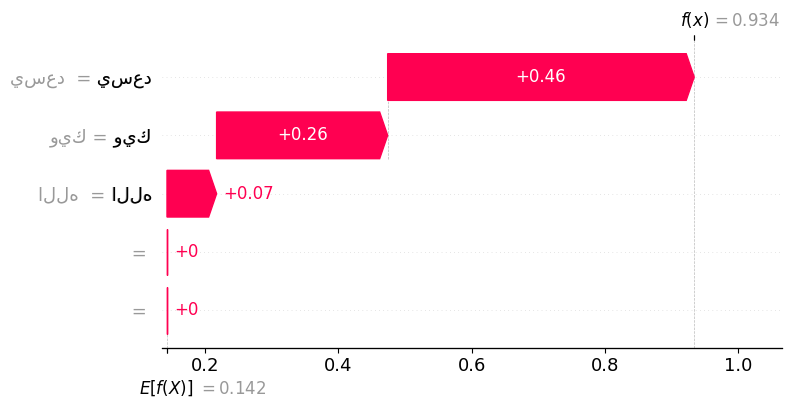

tweet: ايه دا 😨 !! زي الملايكه اما تشوفها والله ياجدعان .✋, true label: surprise
light: خوف الملايكه اما تشوف والله ياجدع, pred label: fear


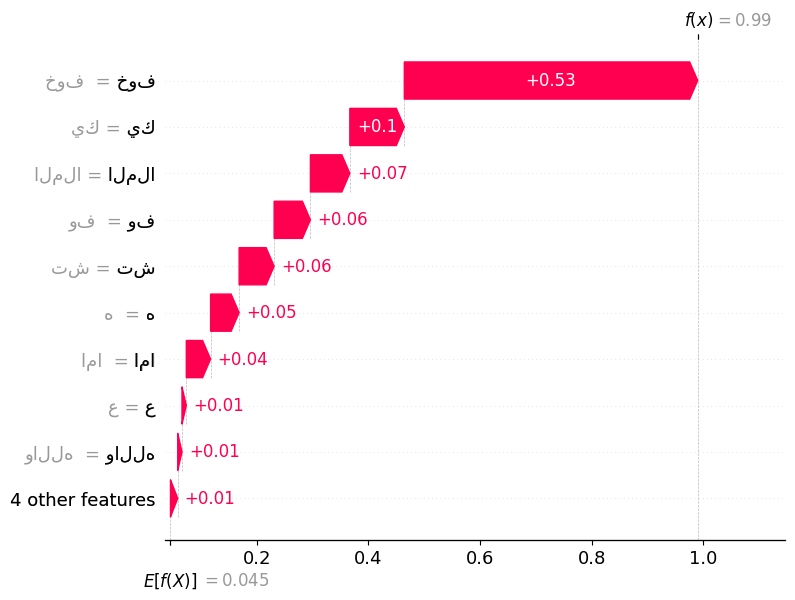

tweet: الصبر لسه ساكت يا ويلي من سكاته, true label: fear
light: الصبر لسه ساكت ويلي سكاته, pred label: sadness


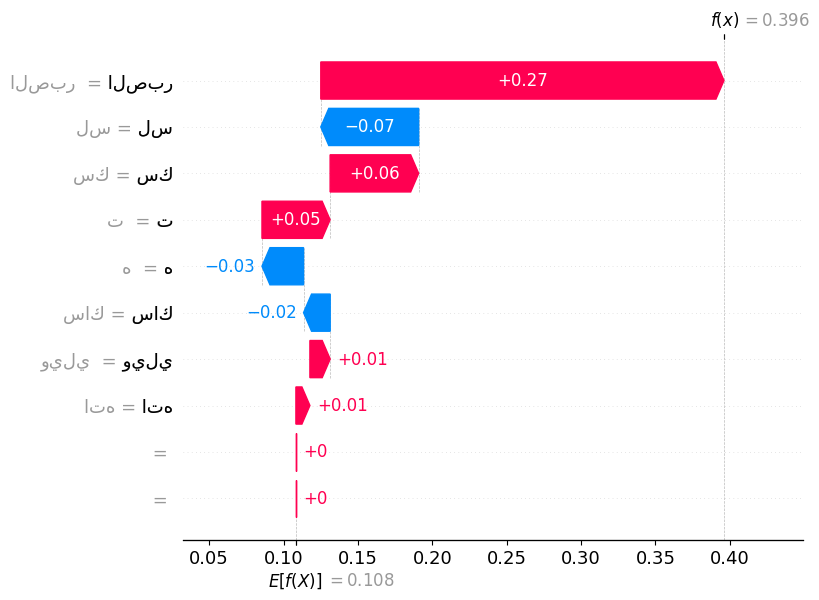

In [53]:
for index in range(8):
  show_plots(np.array(wrong_outputs)[index], index, wrong=True, plot='waterfall')

####Correctly Classified

tweet: هو في كام قطري في بعثه قطر في الاوليمبياد؟, true label: none
light: كام قطري بعثه قطر الاوليمبياد, pred label: none


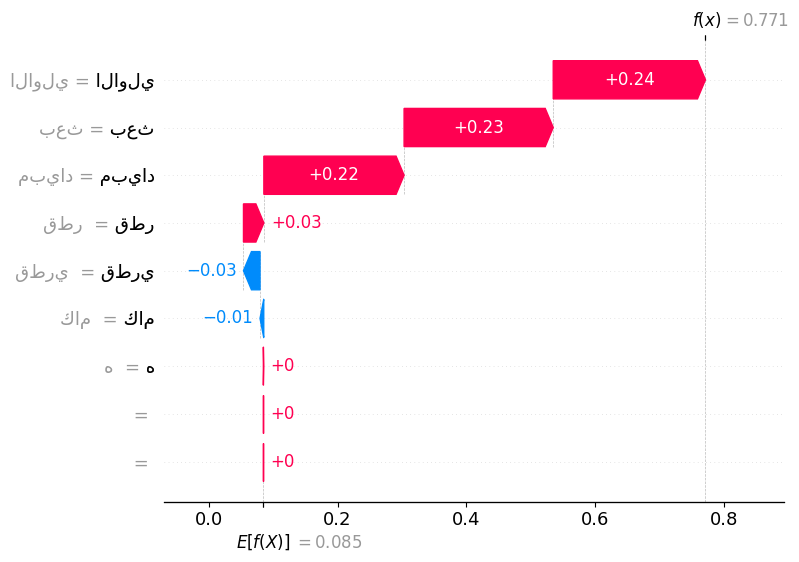

tweet: هو الواد محمد هاني ده مقموص من حاجه!! يعني جي يلعب غصب عنه او ببلاش مثلا..!!  الاهلي, true label: anger
light: الواد محمد هاني مقموص حاجه جي يلعب غصب ببلاش مثلا الاهلي, pred label: anger


Partition explainer: 9it [00:11,  5.63s/it]


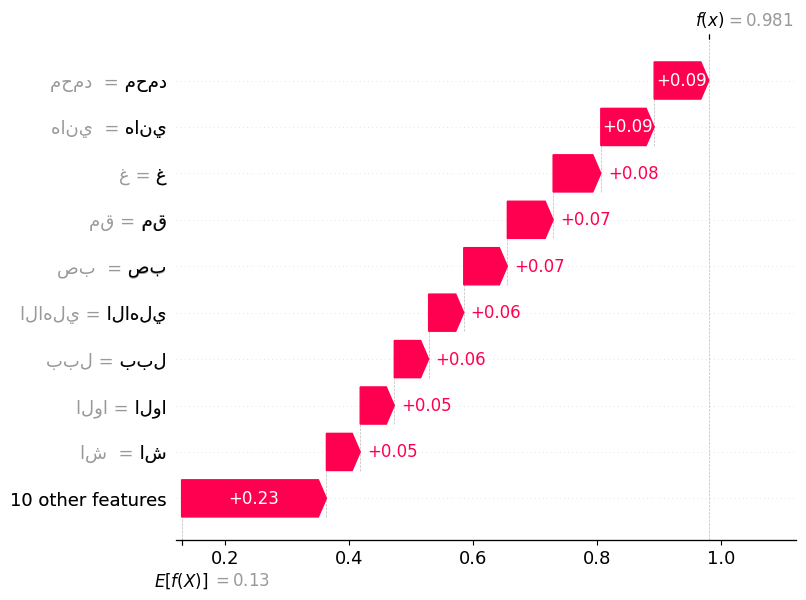

tweet: صوتك ده ايه الله عليه ملايكه بيغنوا ..., true label: joy
light: صوتك الله ملايكه بيغن, pred label: joy


Partition explainer: 9it [00:11,  5.61s/it]


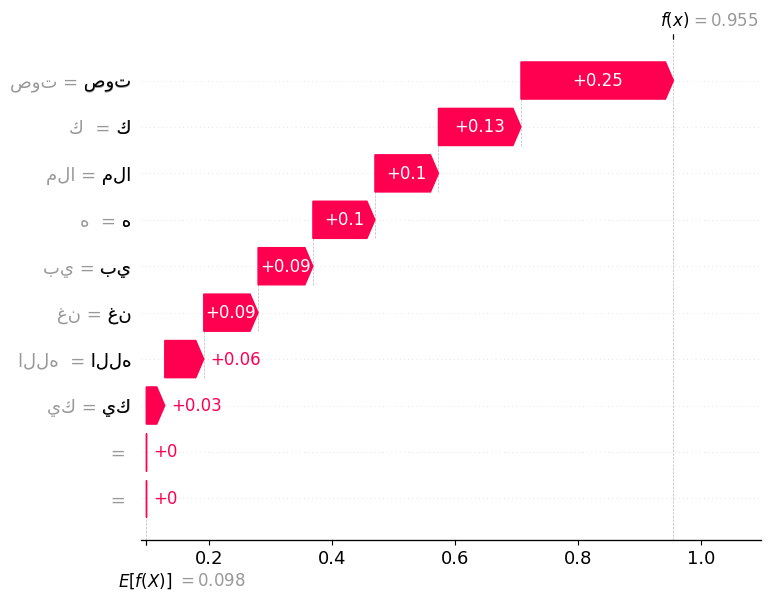

tweet: : حتي اقرب الشخاص ~ يخذلوننا ~ وما اقساها من  خيبه.. 💔, true label: sadness
light: اقرب الشخاص يخذلون اقسا خيبه حزن, pred label: sadness


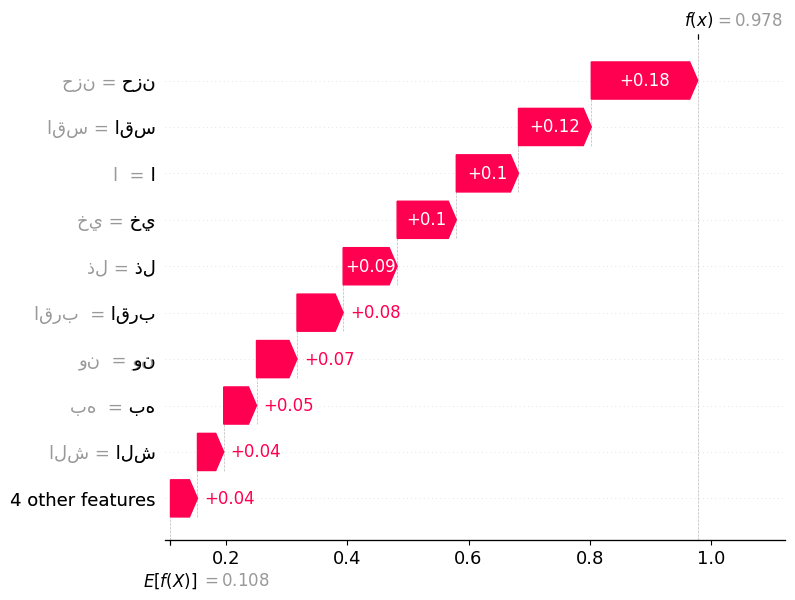

tweet: انا بقربگ اعيش الهنا 💋💕🍃, true label: love
light: بقربگ اعيش اله حب حب, pred label: love


Partition explainer: 9it [00:10, 10.18s/it]               


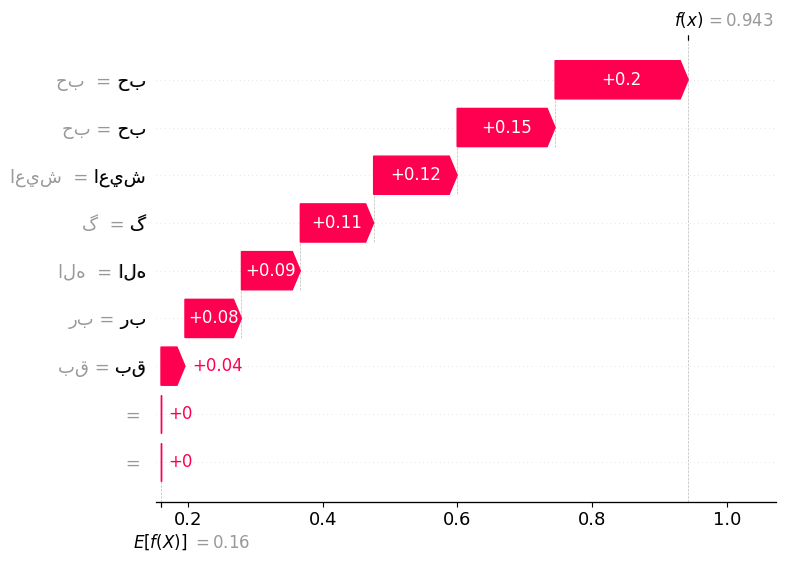

tweet: ذوي الاحتياجات فئه يجب ان تذلل لهم جميع العقبات كان الله في عونهم ., true label: sympathy
light: الاحتياج فئه يجب تذلل العقب الله عون, pred label: sympathy


Partition explainer: 9it [00:12,  4.16s/it]


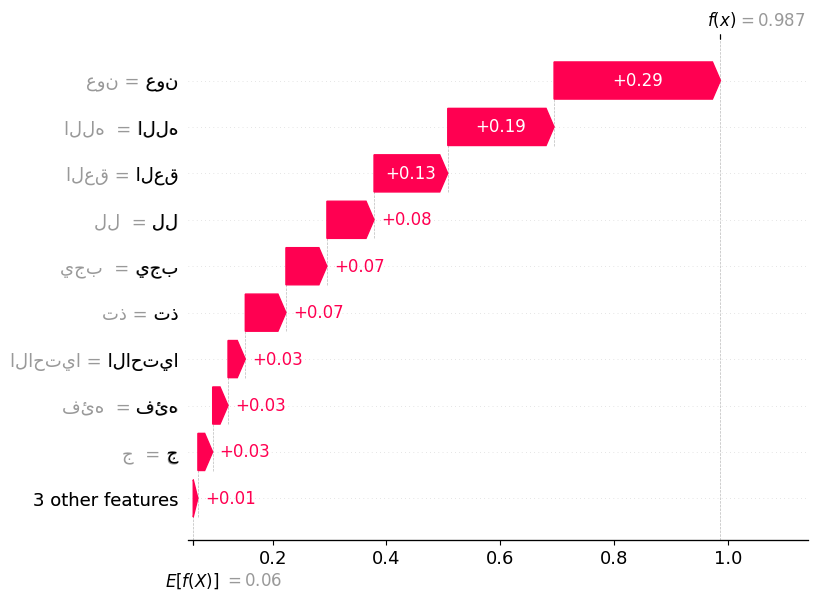

tweet: ده كل لما مصر تفتح معبر يحصل تفجير كل دي صدف؟, true label: surprise
light: مصر تفتح معبر يحصل تفجير صدف, pred label: surprise


Partition explainer: 9it [00:11, 11.43s/it]               


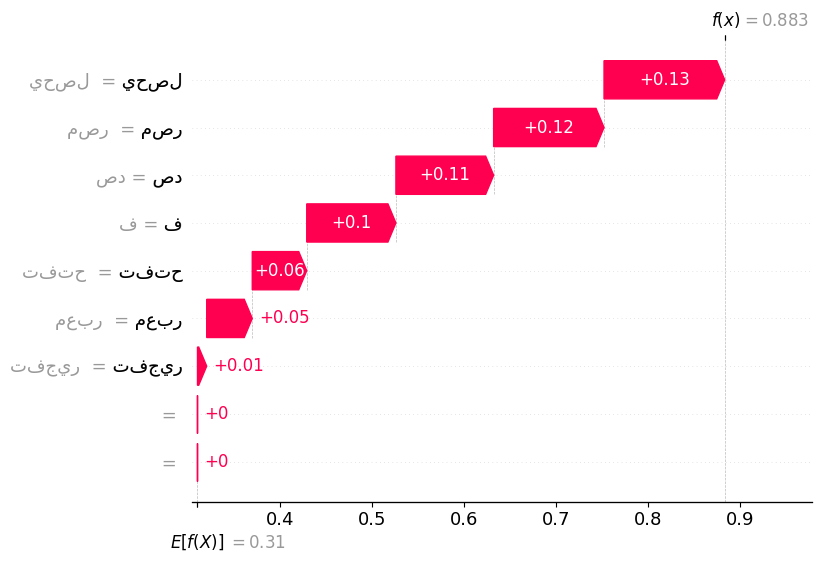

tweet: انا كل الي خايفه منه ان يطلع عندي امتحان بكره وانا معرفش..., true label: fear
light: خايفه يطلع امتح بكره معرفش, pred label: fear


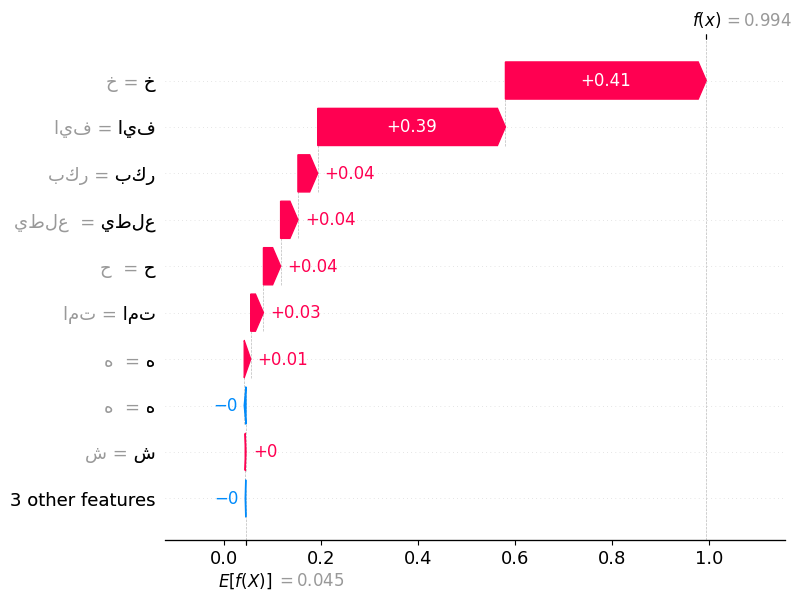

In [54]:
for index in range(8):
  show_plots(np.array(correct_outputs)[index], index, wrong=False, plot='waterfall')

###Bar Plot

####Misclassified

tweet: ماتش ليفربول و برشلونه مع الاوليمبياد ،،، توقيت مش مناسب الصراحه, true label: none
light: ماتش ليفربول برشلونه الاوليمبياد توقيت مش مناسب الصراحه, pred label: surprise


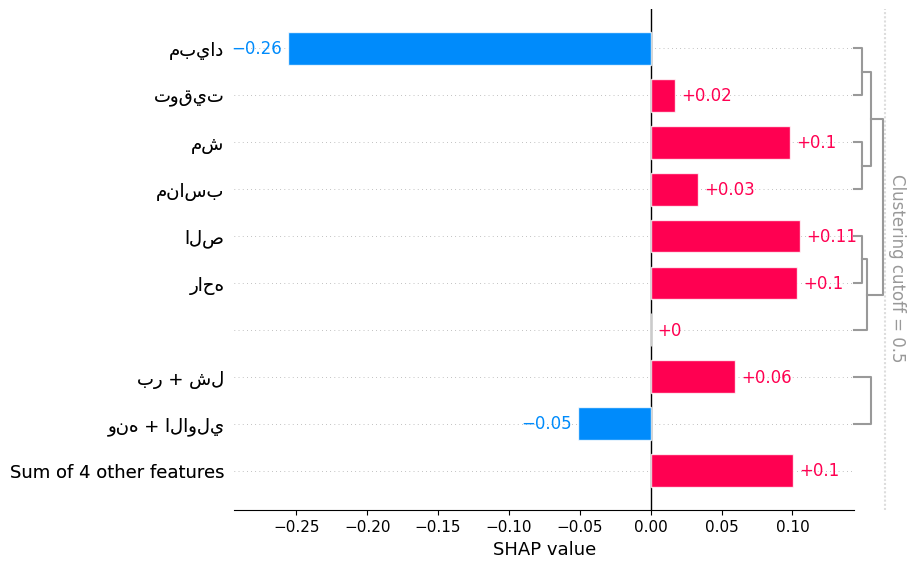

tweet: هيا الاوليمبياد دي هتخلص امتي عشان انا اتخنقت, true label: anger
light: الاوليمبياد هتخلص امتي عشان اتخنقت, pred label: sadness


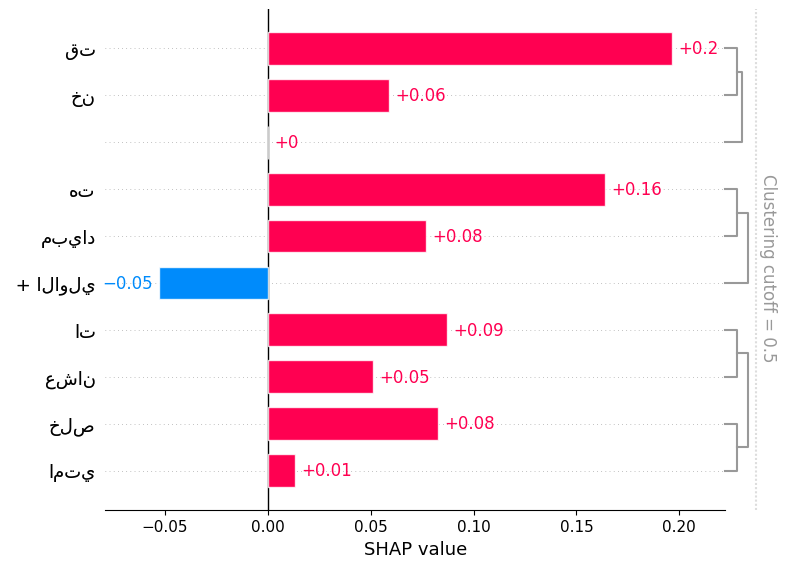

tweet: يا،ما شاء الله  مصر في الاوليمبياد, true label: joy
light: ياما شاء الله مصر الاوليمبياد, pred label: sadness


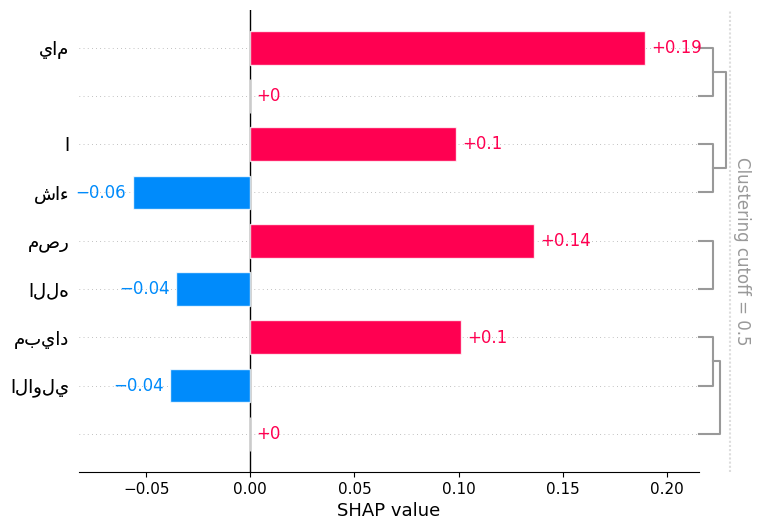

tweet: الملاعب بتاعت الاوليمبياد سيئه جداً, true label: sadness
light: الملاعب بتاعت الاوليمبياد سيئه, pred label: none


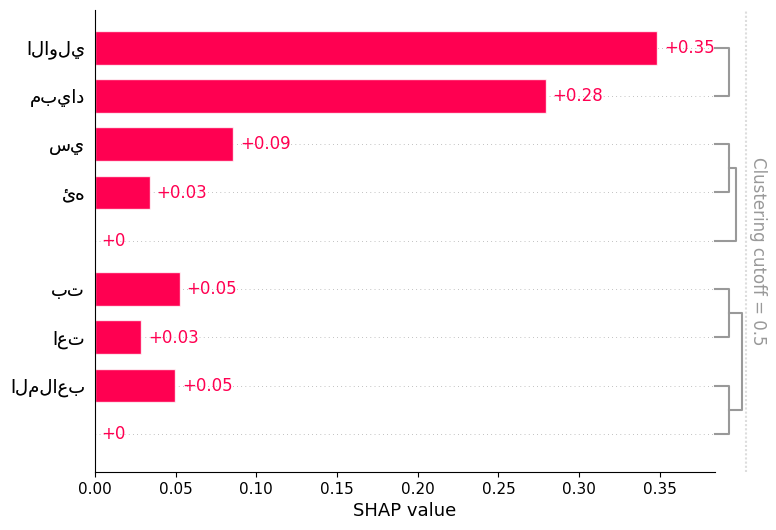

tweet: عمر السومه افضل محترف يمر علي الكره السعوديه هل من معترض ., true label: love
light: عمر السومه افضل محترف يمر الكره السعوديه معترض, pred label: surprise


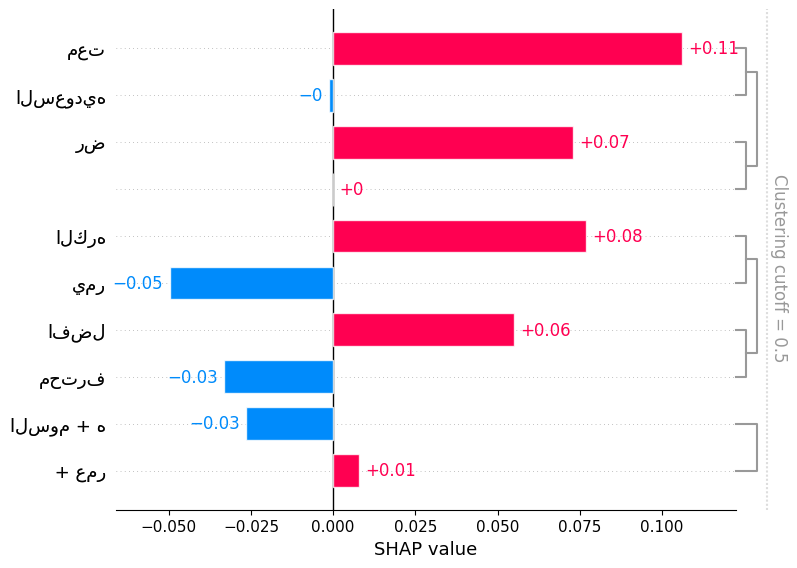

tweet: الله يسعدكم. ويكون معكم, true label: sympathy
light: الله يسعد ويك, pred label: joy


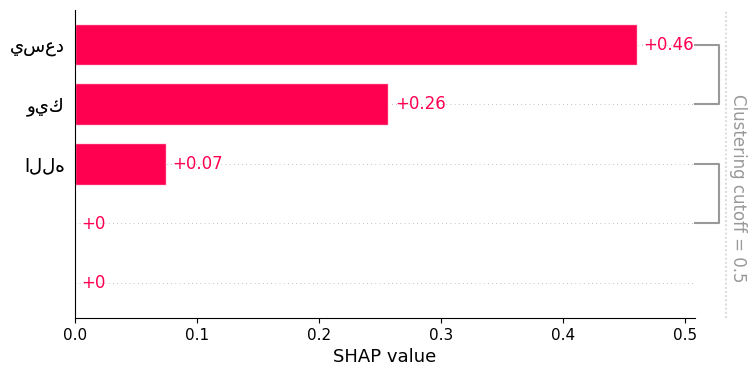

tweet: ايه دا 😨 !! زي الملايكه اما تشوفها والله ياجدعان .✋, true label: surprise
light: خوف الملايكه اما تشوف والله ياجدع, pred label: fear


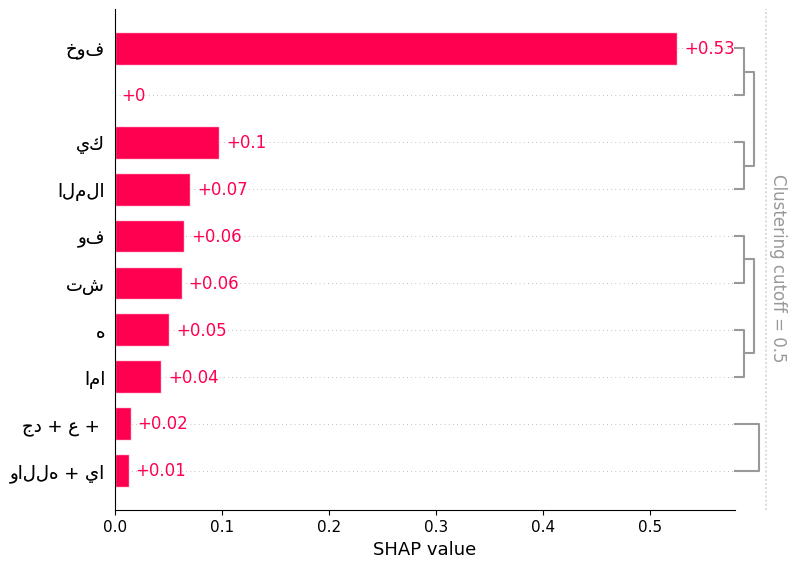

tweet: الصبر لسه ساكت يا ويلي من سكاته, true label: fear
light: الصبر لسه ساكت ويلي سكاته, pred label: sadness


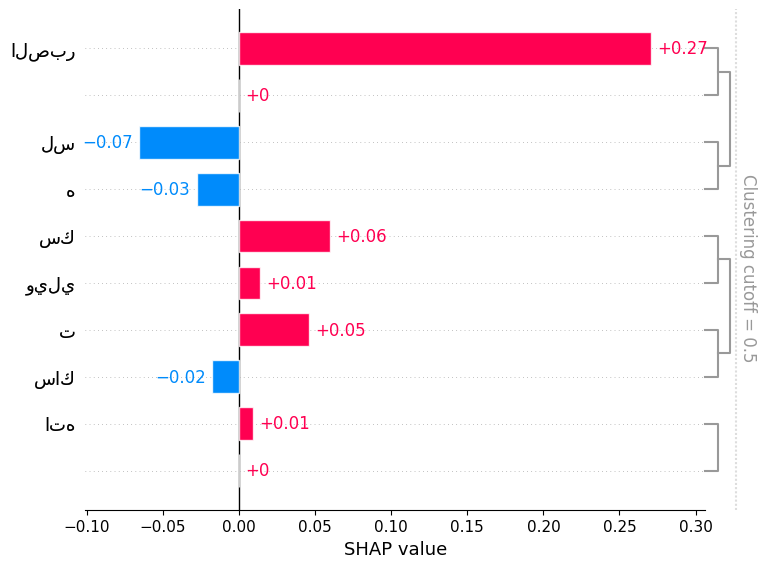

In [55]:
for index in range(8):
  show_plots(np.array(wrong_outputs)[index], index, wrong=True, plot='bar')

####Correctly Classified

tweet: هو في كام قطري في بعثه قطر في الاوليمبياد؟, true label: none
light: كام قطري بعثه قطر الاوليمبياد, pred label: none


Partition explainer: 9it [00:13,  4.39s/it]


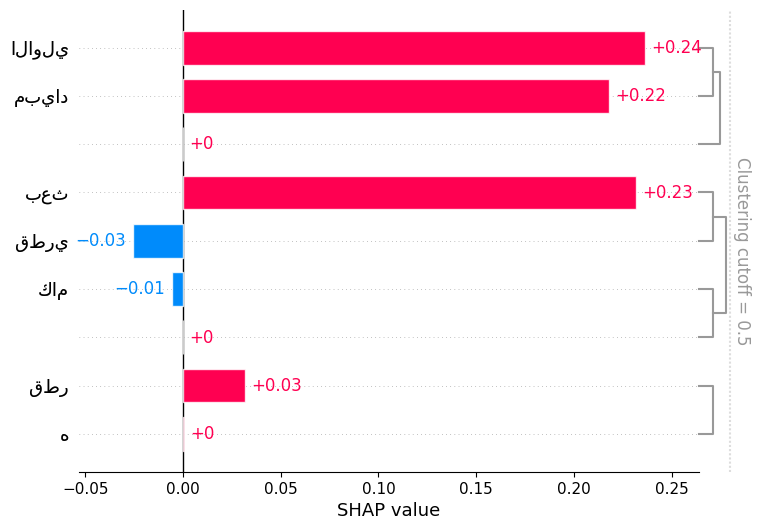

tweet: هو الواد محمد هاني ده مقموص من حاجه!! يعني جي يلعب غصب عنه او ببلاش مثلا..!!  الاهلي, true label: anger
light: الواد محمد هاني مقموص حاجه جي يلعب غصب ببلاش مثلا الاهلي, pred label: anger


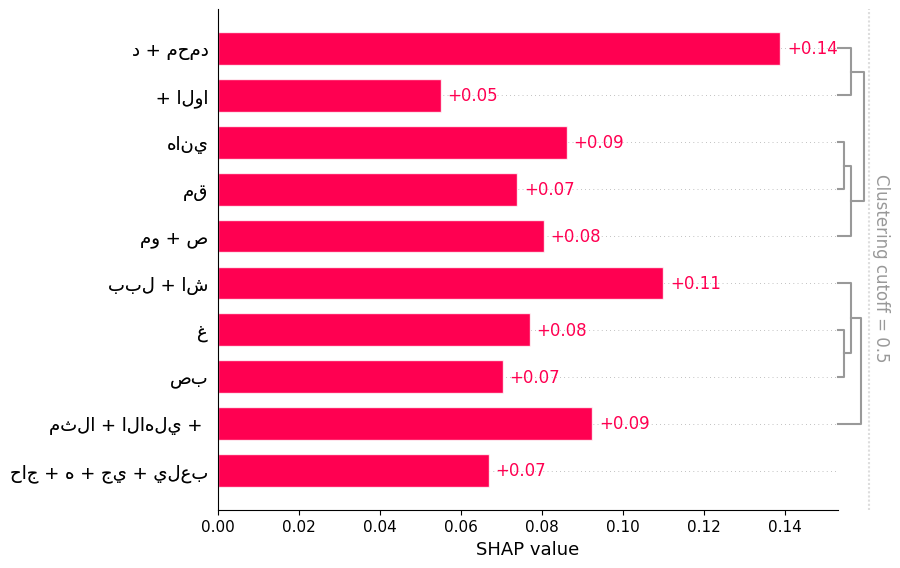

tweet: صوتك ده ايه الله عليه ملايكه بيغنوا ..., true label: joy
light: صوتك الله ملايكه بيغن, pred label: joy


Partition explainer: 9it [00:11, 11.14s/it]               


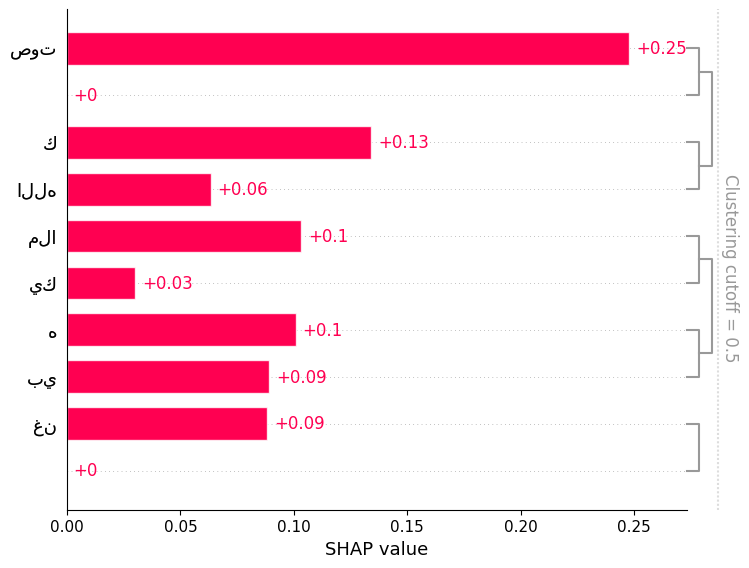

tweet: : حتي اقرب الشخاص ~ يخذلوننا ~ وما اقساها من  خيبه.. 💔, true label: sadness
light: اقرب الشخاص يخذلون اقسا خيبه حزن, pred label: sadness


Partition explainer: 9it [00:11,  5.72s/it]


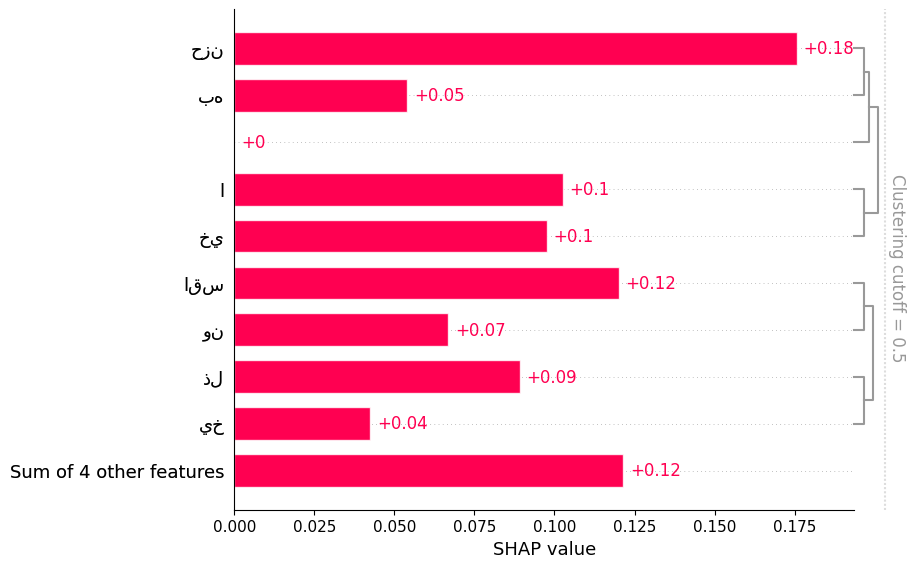

tweet: انا بقربگ اعيش الهنا 💋💕🍃, true label: love
light: بقربگ اعيش اله حب حب, pred label: love


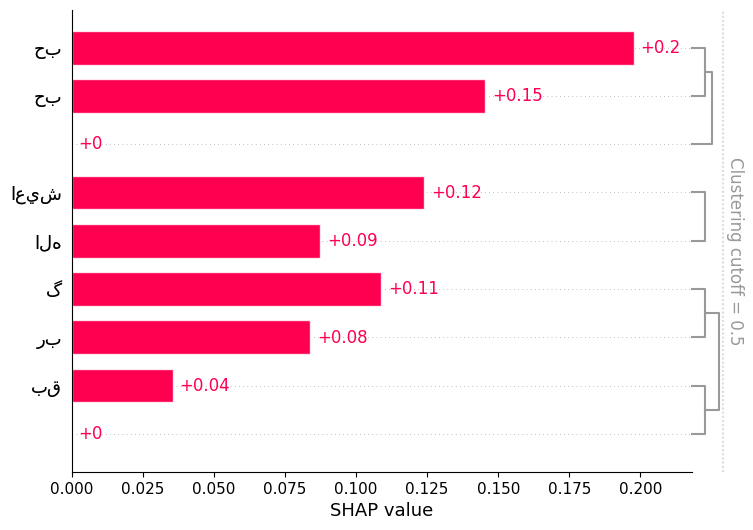

tweet: ذوي الاحتياجات فئه يجب ان تذلل لهم جميع العقبات كان الله في عونهم ., true label: sympathy
light: الاحتياج فئه يجب تذلل العقب الله عون, pred label: sympathy


Partition explainer: 9it [00:10, 10.48s/it]               


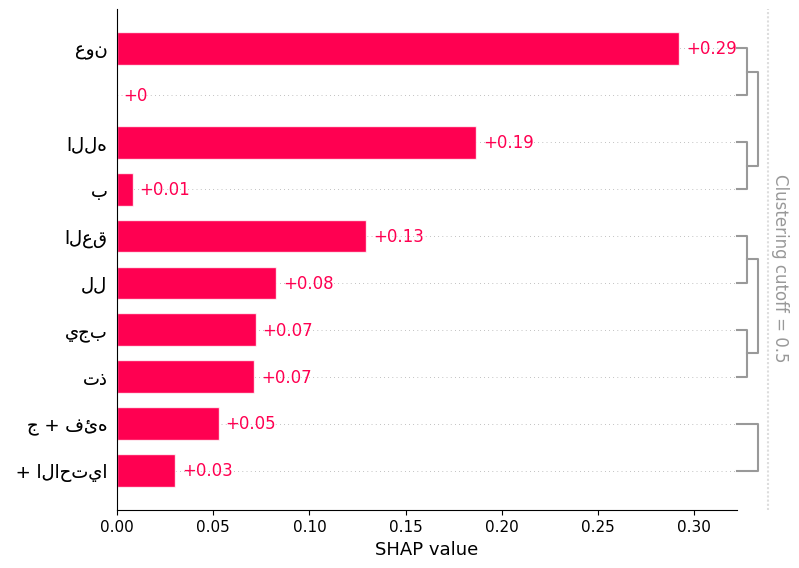

tweet: ده كل لما مصر تفتح معبر يحصل تفجير كل دي صدف؟, true label: surprise
light: مصر تفتح معبر يحصل تفجير صدف, pred label: surprise


Partition explainer: 9it [00:11,  5.69s/it]


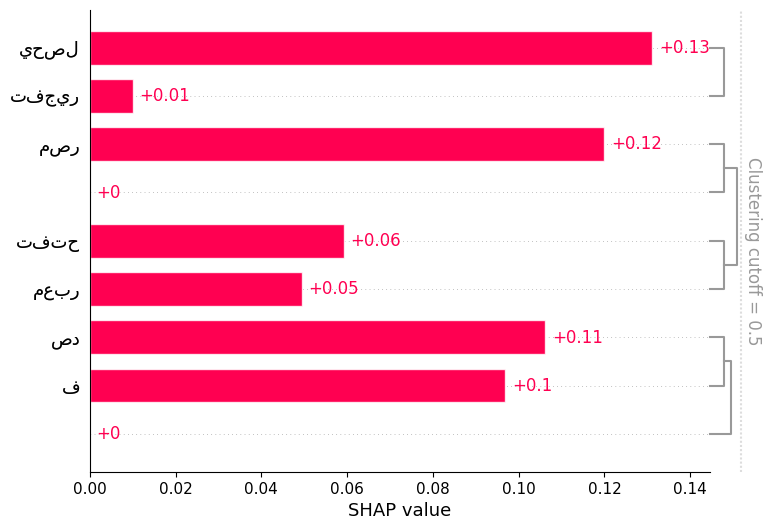

tweet: انا كل الي خايفه منه ان يطلع عندي امتحان بكره وانا معرفش..., true label: fear
light: خايفه يطلع امتح بكره معرفش, pred label: fear


Partition explainer: 9it [00:10, 10.78s/it]               


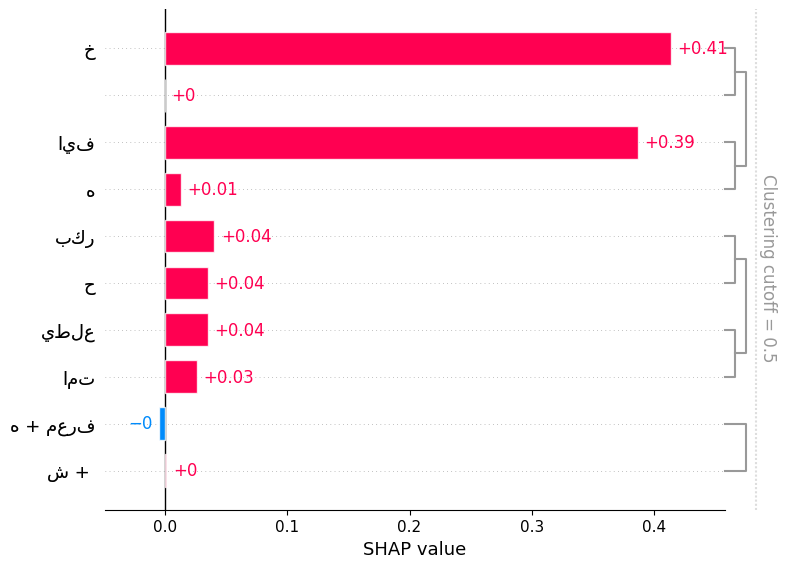

In [56]:
for index in range(8):
  show_plots(np.array(correct_outputs)[index], index, wrong=False, plot='bar')

##LIME

In [57]:
def predict_proba(tweets):
  output = []
  for tweet in tweets:
    result = pred(tweet)[0]
    scores = [x["score"] for x in result]
    labels = [x["label"] for x in result]
    output.append(np.array([x for _, x in sorted(zip(labels, scores))]).reshape(1,-1))
  return np.array(output).squeeze()

In [58]:
from lime.lime_text import LimeTextExplainer

def show_lime(index, wrong):

  preprocs_sample = print_sample(index, wrong)
  if wrong:
    p = np.array(wrong_outputs)[index]
  else:
    p = np.array(correct_outputs)[index]
  prediction = (p,)

  exp = lime_explainer.explain_instance(preprocs_sample, predict_proba, labels=prediction)
  exp.show_in_notebook()

lime_explainer = LimeTextExplainer(class_names=classes)

###Misclassified

In [59]:
for index in range(8):
  show_lime(index, wrong=True)

tweet: ماتش ليفربول و برشلونه مع الاوليمبياد ،،، توقيت مش مناسب الصراحه, true label: none
light: ماتش ليفربول برشلونه الاوليمبياد توقيت مش مناسب الصراحه, pred label: surprise


tweet: هيا الاوليمبياد دي هتخلص امتي عشان انا اتخنقت, true label: anger
light: الاوليمبياد هتخلص امتي عشان اتخنقت, pred label: sadness


You seem to be using the pipelines sequentially on GPU. In order to maximize efficiency please use a dataset


tweet: يا،ما شاء الله  مصر في الاوليمبياد, true label: joy
light: ياما شاء الله مصر الاوليمبياد, pred label: sadness


You seem to be using the pipelines sequentially on GPU. In order to maximize efficiency please use a dataset


tweet: الملاعب بتاعت الاوليمبياد سيئه جداً, true label: sadness
light: الملاعب بتاعت الاوليمبياد سيئه, pred label: none


You seem to be using the pipelines sequentially on GPU. In order to maximize efficiency please use a dataset


tweet: عمر السومه افضل محترف يمر علي الكره السعوديه هل من معترض ., true label: love
light: عمر السومه افضل محترف يمر الكره السعوديه معترض, pred label: surprise


You seem to be using the pipelines sequentially on GPU. In order to maximize efficiency please use a dataset


tweet: الله يسعدكم. ويكون معكم, true label: sympathy
light: الله يسعد ويك, pred label: joy


You seem to be using the pipelines sequentially on GPU. In order to maximize efficiency please use a dataset


tweet: ايه دا 😨 !! زي الملايكه اما تشوفها والله ياجدعان .✋, true label: surprise
light: خوف الملايكه اما تشوف والله ياجدع, pred label: fear


You seem to be using the pipelines sequentially on GPU. In order to maximize efficiency please use a dataset


tweet: الصبر لسه ساكت يا ويلي من سكاته, true label: fear
light: الصبر لسه ساكت ويلي سكاته, pred label: sadness


You seem to be using the pipelines sequentially on GPU. In order to maximize efficiency please use a dataset


###Correctly Classified

In [60]:
for index in range(8):
  show_lime(index, wrong=False)

tweet: هو في كام قطري في بعثه قطر في الاوليمبياد؟, true label: none
light: كام قطري بعثه قطر الاوليمبياد, pred label: none


You seem to be using the pipelines sequentially on GPU. In order to maximize efficiency please use a dataset


tweet: هو الواد محمد هاني ده مقموص من حاجه!! يعني جي يلعب غصب عنه او ببلاش مثلا..!!  الاهلي, true label: anger
light: الواد محمد هاني مقموص حاجه جي يلعب غصب ببلاش مثلا الاهلي, pred label: anger


You seem to be using the pipelines sequentially on GPU. In order to maximize efficiency please use a dataset


tweet: صوتك ده ايه الله عليه ملايكه بيغنوا ..., true label: joy
light: صوتك الله ملايكه بيغن, pred label: joy


You seem to be using the pipelines sequentially on GPU. In order to maximize efficiency please use a dataset


tweet: : حتي اقرب الشخاص ~ يخذلوننا ~ وما اقساها من  خيبه.. 💔, true label: sadness
light: اقرب الشخاص يخذلون اقسا خيبه حزن, pred label: sadness


You seem to be using the pipelines sequentially on GPU. In order to maximize efficiency please use a dataset


tweet: انا بقربگ اعيش الهنا 💋💕🍃, true label: love
light: بقربگ اعيش اله حب حب, pred label: love


You seem to be using the pipelines sequentially on GPU. In order to maximize efficiency please use a dataset


tweet: ذوي الاحتياجات فئه يجب ان تذلل لهم جميع العقبات كان الله في عونهم ., true label: sympathy
light: الاحتياج فئه يجب تذلل العقب الله عون, pred label: sympathy


You seem to be using the pipelines sequentially on GPU. In order to maximize efficiency please use a dataset


tweet: ده كل لما مصر تفتح معبر يحصل تفجير كل دي صدف؟, true label: surprise
light: مصر تفتح معبر يحصل تفجير صدف, pred label: surprise


You seem to be using the pipelines sequentially on GPU. In order to maximize efficiency please use a dataset


tweet: انا كل الي خايفه منه ان يطلع عندي امتحان بكره وانا معرفش..., true label: fear
light: خايفه يطلع امتح بكره معرفش, pred label: fear


You seem to be using the pipelines sequentially on GPU. In order to maximize efficiency please use a dataset


##Tranformers Interpret

In [61]:
from transformers_interpret import SequenceClassificationExplainer

cls_explainer = SequenceClassificationExplainer(model=model, tokenizer=tokenizer, custom_labels=classes)

def interpret_transformer(wrong):
  if wrong:
    samples = wrong_samples
  else:
    samples = correct_samples

  for index in range(8):
      preprocs_sample = print_sample(index, wrong)
      attributions = cls_explainer(preprocs_sample)
      html = cls_explainer.visualize()

###Misclassified

In [62]:
interpret_transformer(wrong=True)

tweet: ماتش ليفربول و برشلونه مع الاوليمبياد ،،، توقيت مش مناسب الصراحه, true label: none
light: ماتش ليفربول برشلونه الاوليمبياد توقيت مش مناسب الصراحه, pred label: surprise


True Label,Predicted Label,Attribution Label,Attribution Score,Word Importance
6,surprise (0.16),surprise,-0.35,[CLS] مات ##ش ليفربول بر ##شل ##ونه الاولي ##مبياد توقيت مش مناسب الص ##راحه [SEP]


tweet: هيا الاوليمبياد دي هتخلص امتي عشان انا اتخنقت, true label: anger
light: الاوليمبياد هتخلص امتي عشان اتخنقت, pred label: sadness


True Label,Predicted Label,Attribution Label,Attribution Score,Word Importance
3,sadness (0.18),sadness,0.33,[CLS] الاولي ##مبياد هت ##خلص امتي عشان ات ##خن ##قت [SEP]


tweet: يا،ما شاء الله  مصر في الاوليمبياد, true label: joy
light: ياما شاء الله مصر الاوليمبياد, pred label: sadness


True Label,Predicted Label,Attribution Label,Attribution Score,Word Importance
3,sadness (0.28),sadness,0.78,[CLS] يام ##ا شاء الله مصر الاولي ##مبياد [SEP]


tweet: الملاعب بتاعت الاوليمبياد سيئه جداً, true label: sadness
light: الملاعب بتاعت الاوليمبياد سيئه, pred label: none


True Label,Predicted Label,Attribution Label,Attribution Score,Word Importance
0,none (0.95),none,1.36,[CLS] الملاعب بت ##اعت الاولي ##مبياد سي ##يه [SEP]


tweet: عمر السومه افضل محترف يمر علي الكره السعوديه هل من معترض ., true label: love
light: عمر السومه افضل محترف يمر الكره السعوديه معترض, pred label: surprise


True Label,Predicted Label,Attribution Label,Attribution Score,Word Importance
6,surprise (0.09),surprise,-0.21,[CLS] عمر السوم ##ه افضل محترف يمر الكره السعوديه معت ##رض [SEP]


tweet: الله يسعدكم. ويكون معكم, true label: sympathy
light: الله يسعد ويك, pred label: joy


True Label,Predicted Label,Attribution Label,Attribution Score,Word Importance
2,joy (0.75),joy,1.49,[CLS] الله يسعد ويك [SEP]


tweet: ايه دا 😨 !! زي الملايكه اما تشوفها والله ياجدعان .✋, true label: surprise
light: خوف الملايكه اما تشوف والله ياجدع, pred label: fear


True Label,Predicted Label,Attribution Label,Attribution Score,Word Importance
7,fear (0.99),fear,1.86,[CLS] خوف الملا ##يك ##ه اما تش ##وف والله يا ##جد ##ع [SEP]


tweet: الصبر لسه ساكت يا ويلي من سكاته, true label: fear
light: الصبر لسه ساكت ويلي سكاته, pred label: sadness


True Label,Predicted Label,Attribution Label,Attribution Score,Word Importance
3,sadness (0.70),sadness,1.59,[CLS] الصبر لس ##ه ساك ##ت ويلي سك ##اته [SEP]


###Correctly Classified

In [63]:
interpret_transformer(wrong=False)

tweet: هو في كام قطري في بعثه قطر في الاوليمبياد؟, true label: none
light: كام قطري بعثه قطر الاوليمبياد, pred label: none


True Label,Predicted Label,Attribution Label,Attribution Score,Word Importance
0,none (0.93),none,1.13,[CLS] كام قطري بعث ##ه قطر الاولي ##مبياد [SEP]


tweet: هو الواد محمد هاني ده مقموص من حاجه!! يعني جي يلعب غصب عنه او ببلاش مثلا..!!  الاهلي, true label: anger
light: الواد محمد هاني مقموص حاجه جي يلعب غصب ببلاش مثلا الاهلي, pred label: anger


True Label,Predicted Label,Attribution Label,Attribution Score,Word Importance
1,anger (0.98),anger,3.30,[CLS] الوا ##د محمد هاني مق ##مو ##ص حاج ##ه جي يلعب غ ##صب ببل ##اش مثلا الاهلي [SEP]


tweet: صوتك ده ايه الله عليه ملايكه بيغنوا ..., true label: joy
light: صوتك الله ملايكه بيغن, pred label: joy


True Label,Predicted Label,Attribution Label,Attribution Score,Word Importance
2,joy (0.72),joy,1.45,[CLS] صوت ##ك الله ملا ##يك ##ه بي ##غن [SEP]


tweet: : حتي اقرب الشخاص ~ يخذلوننا ~ وما اقساها من  خيبه.. 💔, true label: sadness
light: اقرب الشخاص يخذلون اقسا خيبه حزن, pred label: sadness


True Label,Predicted Label,Attribution Label,Attribution Score,Word Importance
3,sadness (0.89),sadness,2.11,[CLS] اقرب الش ##خاص يخ ##ذل ##ون اقس ##ا خي ##به حزن [SEP]


tweet: انا بقربگ اعيش الهنا 💋💕🍃, true label: love
light: بقربگ اعيش اله حب حب, pred label: love


True Label,Predicted Label,Attribution Label,Attribution Score,Word Importance
4,love (0.97),love,2.29,[CLS] بق ##رب ##گ اعيش اله حب حب [SEP]


tweet: ذوي الاحتياجات فئه يجب ان تذلل لهم جميع العقبات كان الله في عونهم ., true label: sympathy
light: الاحتياج فئه يجب تذلل العقب الله عون, pred label: sympathy


True Label,Predicted Label,Attribution Label,Attribution Score,Word Importance
5,sympathy (0.98),sympathy,2.65,[CLS] الاحتيا ##ج فيه يجب تذ ##لل العق ##ب الله عون [SEP]


tweet: ده كل لما مصر تفتح معبر يحصل تفجير كل دي صدف؟, true label: surprise
light: مصر تفتح معبر يحصل تفجير صدف, pred label: surprise


True Label,Predicted Label,Attribution Label,Attribution Score,Word Importance
6,surprise (0.81),surprise,1.64,[CLS] مصر تفتح معبر يحصل تفجير صد ##ف [SEP]


tweet: انا كل الي خايفه منه ان يطلع عندي امتحان بكره وانا معرفش..., true label: fear
light: خايفه يطلع امتح بكره معرفش, pred label: fear


True Label,Predicted Label,Attribution Label,Attribution Score,Word Importance
7,fear (0.99),fear,1.89,[CLS] خ ##ايف ##ه يطلع امت ##ح بكر ##ه معرف ##ش [SEP]


##OMNIXAI

###SHAP

In [64]:
from omnixai.data.text import Text
from omnixai.explainers.nlp import ShapText

[nltk_data] Downloading package punkt to /root/nltk_data...
[nltk_data]   Unzipping tokenizers/punkt.zip.


In [65]:
explainer = ShapText(model=pred)
abstract2class = {
    'LABEL_0':classes[0],
    'LABEL_1':classes[1],
    'LABEL_2':classes[2],
    'LABEL_3':classes[3],
    'LABEL_4':classes[4],
    'LABEL_5':classes[5],
    'LABEL_6':classes[6],
    'LABEL_7':classes[7]
}

####Misclassified

In [66]:
explanations = explainer.explain(Text(wrong_samples['Light Stemming']))
for index in range(8):
  print_sample(index, wrong=True)
  explanations.ipython_plot(index=index, class_names=abstract2class)

You seem to be using the pipelines sequentially on GPU. In order to maximize efficiency please use a dataset


tweet: ماتش ليفربول و برشلونه مع الاوليمبياد ،،، توقيت مش مناسب الصراحه, true label: none
light: ماتش ليفربول برشلونه الاوليمبياد توقيت مش مناسب الصراحه, pred label: surprise


tweet: هيا الاوليمبياد دي هتخلص امتي عشان انا اتخنقت, true label: anger
light: الاوليمبياد هتخلص امتي عشان اتخنقت, pred label: sadness


tweet: يا،ما شاء الله  مصر في الاوليمبياد, true label: joy
light: ياما شاء الله مصر الاوليمبياد, pred label: sadness


tweet: الملاعب بتاعت الاوليمبياد سيئه جداً, true label: sadness
light: الملاعب بتاعت الاوليمبياد سيئه, pred label: none


tweet: عمر السومه افضل محترف يمر علي الكره السعوديه هل من معترض ., true label: love
light: عمر السومه افضل محترف يمر الكره السعوديه معترض, pred label: surprise


tweet: الله يسعدكم. ويكون معكم, true label: sympathy
light: الله يسعد ويك, pred label: joy


tweet: ايه دا 😨 !! زي الملايكه اما تشوفها والله ياجدعان .✋, true label: surprise
light: خوف الملايكه اما تشوف والله ياجدع, pred label: fear


tweet: الصبر لسه ساكت يا ويلي من سكاته, true label: fear
light: الصبر لسه ساكت ويلي سكاته, pred label: sadness


####Correctly Classified

In [67]:
explanations = explainer.explain(Text(correct_samples['Light Stemming']))
for index in range(8):
  print_sample(index, wrong=False)
  explanations.ipython_plot(index=index, class_names=abstract2class)

Partition explainer: 9it [00:11, 11.04s/it]               

tweet: هو في كام قطري في بعثه قطر في الاوليمبياد؟, true label: none
light: كام قطري بعثه قطر الاوليمبياد, pred label: none


tweet: هو الواد محمد هاني ده مقموص من حاجه!! يعني جي يلعب غصب عنه او ببلاش مثلا..!!  الاهلي, true label: anger
light: الواد محمد هاني مقموص حاجه جي يلعب غصب ببلاش مثلا الاهلي, pred label: anger


tweet: صوتك ده ايه الله عليه ملايكه بيغنوا ..., true label: joy
light: صوتك الله ملايكه بيغن, pred label: joy


tweet: : حتي اقرب الشخاص ~ يخذلوننا ~ وما اقساها من  خيبه.. 💔, true label: sadness
light: اقرب الشخاص يخذلون اقسا خيبه حزن, pred label: sadness


tweet: انا بقربگ اعيش الهنا 💋💕🍃, true label: love
light: بقربگ اعيش اله حب حب, pred label: love


tweet: ذوي الاحتياجات فئه يجب ان تذلل لهم جميع العقبات كان الله في عونهم ., true label: sympathy
light: الاحتياج فئه يجب تذلل العقب الله عون, pred label: sympathy


tweet: ده كل لما مصر تفتح معبر يحصل تفجير كل دي صدف؟, true label: surprise
light: مصر تفتح معبر يحصل تفجير صدف, pred label: surprise


tweet: انا كل الي خايفه منه ان يطلع عندي امتحان بكره وانا معرفش..., true label: fear
light: خايفه يطلع امتح بكره معرفش, pred label: fear


###LIME

In [68]:
from omnixai.data.text import Text
from omnixai.explainers.nlp import LimeText

In [69]:
def predict_proba2(tweets):
  output = []
  tweets = tweets.to_str()
  for tweet in tweets:
    result = pred(tweet)[0]
    scores = [i["score"] for i in result]
    labels = [i["label"] for i in result]
    output.append(np.array([i for _, i in sorted(zip(labels, scores))]).reshape(1, -1))
  return np.array(output).squeeze()

predict_function = lambda x: predict_proba2(x)

In [70]:
explainer = LimeText(predict_function=predict_function)

####Misclassified

In [71]:
explanations = explainer.explain(Text(wrong_samples['Light Stemming']))

for index in range(8):
  print_sample(index, wrong=True)
  explanations.ipython_plot(index=index, class_names=classes)

You seem to be using the pipelines sequentially on GPU. In order to maximize efficiency please use a dataset
You seem to be using the pipelines sequentially on GPU. In order to maximize efficiency please use a dataset
You seem to be using the pipelines sequentially on GPU. In order to maximize efficiency please use a dataset
You seem to be using the pipelines sequentially on GPU. In order to maximize efficiency please use a dataset
You seem to be using the pipelines sequentially on GPU. In order to maximize efficiency please use a dataset
You seem to be using the pipelines sequentially on GPU. In order to maximize efficiency please use a dataset
You seem to be using the pipelines sequentially on GPU. In order to maximize efficiency please use a dataset


tweet: ماتش ليفربول و برشلونه مع الاوليمبياد ،،، توقيت مش مناسب الصراحه, true label: none
light: ماتش ليفربول برشلونه الاوليمبياد توقيت مش مناسب الصراحه, pred label: surprise


tweet: هيا الاوليمبياد دي هتخلص امتي عشان انا اتخنقت, true label: anger
light: الاوليمبياد هتخلص امتي عشان اتخنقت, pred label: sadness


tweet: يا،ما شاء الله  مصر في الاوليمبياد, true label: joy
light: ياما شاء الله مصر الاوليمبياد, pred label: sadness


tweet: الملاعب بتاعت الاوليمبياد سيئه جداً, true label: sadness
light: الملاعب بتاعت الاوليمبياد سيئه, pred label: none


tweet: عمر السومه افضل محترف يمر علي الكره السعوديه هل من معترض ., true label: love
light: عمر السومه افضل محترف يمر الكره السعوديه معترض, pred label: surprise


tweet: الله يسعدكم. ويكون معكم, true label: sympathy
light: الله يسعد ويك, pred label: joy


tweet: ايه دا 😨 !! زي الملايكه اما تشوفها والله ياجدعان .✋, true label: surprise
light: خوف الملايكه اما تشوف والله ياجدع, pred label: fear


tweet: الصبر لسه ساكت يا ويلي من سكاته, true label: fear
light: الصبر لسه ساكت ويلي سكاته, pred label: sadness


####Correctly Classified

In [72]:
explanations = explainer.explain(Text(correct_samples['Light Stemming']))

for index in range(8):
  print_sample(index, wrong=False)
  explanations.ipython_plot(index=index, class_names=classes)

You seem to be using the pipelines sequentially on GPU. In order to maximize efficiency please use a dataset
You seem to be using the pipelines sequentially on GPU. In order to maximize efficiency please use a dataset
You seem to be using the pipelines sequentially on GPU. In order to maximize efficiency please use a dataset
You seem to be using the pipelines sequentially on GPU. In order to maximize efficiency please use a dataset
You seem to be using the pipelines sequentially on GPU. In order to maximize efficiency please use a dataset
You seem to be using the pipelines sequentially on GPU. In order to maximize efficiency please use a dataset
You seem to be using the pipelines sequentially on GPU. In order to maximize efficiency please use a dataset
You seem to be using the pipelines sequentially on GPU. In order to maximize efficiency please use a dataset


tweet: هو في كام قطري في بعثه قطر في الاوليمبياد؟, true label: none
light: كام قطري بعثه قطر الاوليمبياد, pred label: none


tweet: هو الواد محمد هاني ده مقموص من حاجه!! يعني جي يلعب غصب عنه او ببلاش مثلا..!!  الاهلي, true label: anger
light: الواد محمد هاني مقموص حاجه جي يلعب غصب ببلاش مثلا الاهلي, pred label: anger


tweet: صوتك ده ايه الله عليه ملايكه بيغنوا ..., true label: joy
light: صوتك الله ملايكه بيغن, pred label: joy


tweet: : حتي اقرب الشخاص ~ يخذلوننا ~ وما اقساها من  خيبه.. 💔, true label: sadness
light: اقرب الشخاص يخذلون اقسا خيبه حزن, pred label: sadness


tweet: انا بقربگ اعيش الهنا 💋💕🍃, true label: love
light: بقربگ اعيش اله حب حب, pred label: love


tweet: ذوي الاحتياجات فئه يجب ان تذلل لهم جميع العقبات كان الله في عونهم ., true label: sympathy
light: الاحتياج فئه يجب تذلل العقب الله عون, pred label: sympathy


tweet: ده كل لما مصر تفتح معبر يحصل تفجير كل دي صدف؟, true label: surprise
light: مصر تفتح معبر يحصل تفجير صدف, pred label: surprise


tweet: انا كل الي خايفه منه ان يطلع عندي امتحان بكره وانا معرفش..., true label: fear
light: خايفه يطلع امتح بكره معرفش, pred label: fear


###L2X

In [73]:
from omnixai.explainers.nlp.agnostic.l2x import L2XText

In [74]:
explainer = L2XText(
    training_data=Text(X_train['Light Stemming']),
    predict_function=predict_function
)

You seem to be using the pipelines sequentially on GPU. In order to maximize efficiency please use a dataset


 |████████████████████████████████████████| 100.0% Complete, Loss 0.0080
L2X prediction model accuracy: 0.9707594038325054


####Misclassified

In [75]:
explanations = explainer.explain(Text(wrong_samples['Light Stemming']))

for index in range(8):
  print_sample(index, wrong=True)
  explanations.ipython_plot(index=index, class_names=classes)

tweet: ماتش ليفربول و برشلونه مع الاوليمبياد ،،، توقيت مش مناسب الصراحه, true label: none
light: ماتش ليفربول برشلونه الاوليمبياد توقيت مش مناسب الصراحه, pred label: surprise


You seem to be using the pipelines sequentially on GPU. In order to maximize efficiency please use a dataset


tweet: هيا الاوليمبياد دي هتخلص امتي عشان انا اتخنقت, true label: anger
light: الاوليمبياد هتخلص امتي عشان اتخنقت, pred label: sadness


tweet: يا،ما شاء الله  مصر في الاوليمبياد, true label: joy
light: ياما شاء الله مصر الاوليمبياد, pred label: sadness


tweet: الملاعب بتاعت الاوليمبياد سيئه جداً, true label: sadness
light: الملاعب بتاعت الاوليمبياد سيئه, pred label: none


tweet: عمر السومه افضل محترف يمر علي الكره السعوديه هل من معترض ., true label: love
light: عمر السومه افضل محترف يمر الكره السعوديه معترض, pred label: surprise


tweet: الله يسعدكم. ويكون معكم, true label: sympathy
light: الله يسعد ويك, pred label: joy


tweet: ايه دا 😨 !! زي الملايكه اما تشوفها والله ياجدعان .✋, true label: surprise
light: خوف الملايكه اما تشوف والله ياجدع, pred label: fear


tweet: الصبر لسه ساكت يا ويلي من سكاته, true label: fear
light: الصبر لسه ساكت ويلي سكاته, pred label: sadness


####Correctly Classified

In [76]:
explanations = explainer.explain(Text(correct_samples['Light Stemming']))

for index in range(8):
  print_sample(index, wrong=False)
  explanations.ipython_plot(index=index, class_names=classes)

tweet: هو في كام قطري في بعثه قطر في الاوليمبياد؟, true label: none
light: كام قطري بعثه قطر الاوليمبياد, pred label: none


tweet: هو الواد محمد هاني ده مقموص من حاجه!! يعني جي يلعب غصب عنه او ببلاش مثلا..!!  الاهلي, true label: anger
light: الواد محمد هاني مقموص حاجه جي يلعب غصب ببلاش مثلا الاهلي, pred label: anger


tweet: صوتك ده ايه الله عليه ملايكه بيغنوا ..., true label: joy
light: صوتك الله ملايكه بيغن, pred label: joy


tweet: : حتي اقرب الشخاص ~ يخذلوننا ~ وما اقساها من  خيبه.. 💔, true label: sadness
light: اقرب الشخاص يخذلون اقسا خيبه حزن, pred label: sadness


tweet: انا بقربگ اعيش الهنا 💋💕🍃, true label: love
light: بقربگ اعيش اله حب حب, pred label: love


tweet: ذوي الاحتياجات فئه يجب ان تذلل لهم جميع العقبات كان الله في عونهم ., true label: sympathy
light: الاحتياج فئه يجب تذلل العقب الله عون, pred label: sympathy


tweet: ده كل لما مصر تفتح معبر يحصل تفجير كل دي صدف؟, true label: surprise
light: مصر تفتح معبر يحصل تفجير صدف, pred label: surprise


tweet: انا كل الي خايفه منه ان يطلع عندي امتحان بكره وانا معرفش..., true label: fear
light: خايفه يطلع امتح بكره معرفش, pred label: fear


##LRP

In [39]:
from interpret_nlp.visualization.heatmap import html_heatmap
from IPython.display import display, HTML

def lrp(data, model, tokenizer, classes):
  model.eval()
  inputs = tokenizer(data, return_tensors="pt")
  logits = model(**inputs).logits.squeeze()
  inputs = tokenizer(data, return_tensors="pt")
  model.attr()
  output = model(**inputs)
  tokens = tokenizer.tokenize(data)
  rel_y = np.zeros(output.shape)
  rel_y[:, 1] = output[:, 1]
  rel_word, rel_pos, rel_type, rel_embed = model.attr_backward(rel_y, eps=.1)
  rel_word = np.sum(rel_word[0, 1:-1], -1)
  rel_pos = np.sum(rel_pos[0, 1:-1], -1)
  rel_type = np.sum(rel_type[0, 1:-1], -1)
  rel_embed = np.sum(rel_embed[0, 1:-1], -1)

  return rel_word, rel_pos, rel_type, rel_embed, tokens

def visualize_lrp(rel_word, rel_pos, rel_type, rel_embed, tokens):
  print("Relevance of word embeddings:\n")
  display(HTML(html_heatmap(tokens, list(rel_word))))
  print("\n")
  print("Relevance of positional embeddings:\n")
  display(HTML(html_heatmap(tokens, list(rel_pos))))
  print("\n")
  print("Relevance of type embeddings:\n")
  display(HTML(html_heatmap(tokens, list(rel_type))))
  print("\n")
  print("Relevance of combined embeddings:\n")
  display(HTML(html_heatmap(tokens, list(rel_embed))))

####Misclassified

In [43]:
for index in range(8):
  print_sample(index, wrong=True)
  wrd, pos, typ, com, tokens = lrp(wrong_samples['Light Stemming'][index], model.cpu(), tokenizer, classes)
  visualize_lrp(wrd, pos, typ, com, tokens)

tweet: ماتش ليفربول و برشلونه مع الاوليمبياد ،،، توقيت مش مناسب الصراحه, true label: none
light: ماتش ليفربول برشلونه الاوليمبياد توقيت مش مناسب الصراحه, pred label: surprise


/usr/local/lib/python3.10/dist-packages/transformers/modeling_utils.py:881: FutureWarning: The `device` argument is deprecated and will be removed in v5 of Transformers.
  warnings.warn(


Relevance of word embeddings:





Relevance of positional embeddings:





Relevance of type embeddings:





Relevance of combined embeddings:



tweet: هيا الاوليمبياد دي هتخلص امتي عشان انا اتخنقت, true label: anger
light: الاوليمبياد هتخلص امتي عشان اتخنقت, pred label: sadness
Relevance of word embeddings:





Relevance of positional embeddings:





Relevance of type embeddings:





Relevance of combined embeddings:



tweet: يا،ما شاء الله  مصر في الاوليمبياد, true label: joy
light: ياما شاء الله مصر الاوليمبياد, pred label: sadness
Relevance of word embeddings:





Relevance of positional embeddings:





Relevance of type embeddings:





Relevance of combined embeddings:



tweet: الملاعب بتاعت الاوليمبياد سيئه جداً, true label: sadness
light: الملاعب بتاعت الاوليمبياد سيئه, pred label: none
Relevance of word embeddings:





Relevance of positional embeddings:





Relevance of type embeddings:





Relevance of combined embeddings:



tweet: عمر السومه افضل محترف يمر علي الكره السعوديه هل من معترض ., true label: love
light: عمر السومه افضل محترف يمر الكره السعوديه معترض, pred label: surprise
Relevance of word embeddings:





Relevance of positional embeddings:





Relevance of type embeddings:





Relevance of combined embeddings:



tweet: الله يسعدكم. ويكون معكم, true label: sympathy
light: الله يسعد ويك, pred label: joy
Relevance of word embeddings:





Relevance of positional embeddings:





Relevance of type embeddings:





Relevance of combined embeddings:



tweet: ايه دا 😨 !! زي الملايكه اما تشوفها والله ياجدعان .✋, true label: surprise
light: خوف الملايكه اما تشوف والله ياجدع, pred label: fear
Relevance of word embeddings:





Relevance of positional embeddings:





Relevance of type embeddings:





Relevance of combined embeddings:



tweet: الصبر لسه ساكت يا ويلي من سكاته, true label: fear
light: الصبر لسه ساكت ويلي سكاته, pred label: sadness
Relevance of word embeddings:





Relevance of positional embeddings:





Relevance of type embeddings:





Relevance of combined embeddings:



####Correctly Classified

In [44]:
for index in range(8):
  print_sample(index, wrong=False)
  wrd, pos, typ, com, tokens = lrp(correct_samples['Light Stemming'][index], model.cpu(), tokenizer, classes)
  visualize_lrp(wrd, pos, typ, com, tokens)

tweet: هو في كام قطري في بعثه قطر في الاوليمبياد؟, true label: none
light: كام قطري بعثه قطر الاوليمبياد, pred label: none
Relevance of word embeddings:





Relevance of positional embeddings:





Relevance of type embeddings:





Relevance of combined embeddings:



tweet: هو الواد محمد هاني ده مقموص من حاجه!! يعني جي يلعب غصب عنه او ببلاش مثلا..!!  الاهلي, true label: anger
light: الواد محمد هاني مقموص حاجه جي يلعب غصب ببلاش مثلا الاهلي, pred label: anger
Relevance of word embeddings:





Relevance of positional embeddings:





Relevance of type embeddings:





Relevance of combined embeddings:



tweet: صوتك ده ايه الله عليه ملايكه بيغنوا ..., true label: joy
light: صوتك الله ملايكه بيغن, pred label: joy
Relevance of word embeddings:





Relevance of positional embeddings:





Relevance of type embeddings:





Relevance of combined embeddings:



tweet: : حتي اقرب الشخاص ~ يخذلوننا ~ وما اقساها من  خيبه.. 💔, true label: sadness
light: اقرب الشخاص يخذلون اقسا خيبه حزن, pred label: sadness
Relevance of word embeddings:





Relevance of positional embeddings:





Relevance of type embeddings:





Relevance of combined embeddings:



tweet: انا بقربگ اعيش الهنا 💋💕🍃, true label: love
light: بقربگ اعيش اله حب حب, pred label: love
Relevance of word embeddings:





Relevance of positional embeddings:





Relevance of type embeddings:





Relevance of combined embeddings:



tweet: ذوي الاحتياجات فئه يجب ان تذلل لهم جميع العقبات كان الله في عونهم ., true label: sympathy
light: الاحتياج فئه يجب تذلل العقب الله عون, pred label: sympathy
Relevance of word embeddings:





Relevance of positional embeddings:





Relevance of type embeddings:





Relevance of combined embeddings:



tweet: ده كل لما مصر تفتح معبر يحصل تفجير كل دي صدف؟, true label: surprise
light: مصر تفتح معبر يحصل تفجير صدف, pred label: surprise
Relevance of word embeddings:





Relevance of positional embeddings:





Relevance of type embeddings:





Relevance of combined embeddings:



tweet: انا كل الي خايفه منه ان يطلع عندي امتحان بكره وانا معرفش..., true label: fear
light: خايفه يطلع امتح بكره معرفش, pred label: fear
Relevance of word embeddings:





Relevance of positional embeddings:





Relevance of type embeddings:





Relevance of combined embeddings:

